# Chapter 12 - Multiple Objective Optimization


© 2021, 2022 Packt Publishing

Written by Alex Khan

In [1]:
# Enter the S3 bucket you created during onboarding in the code below
my_bucket = "amazon-braket-[your bucket]" # the name of the bucket
my_prefix = "[your folder]" # the name of the folder in the bucket
s3_folder = (my_bucket, my_prefix)

In [3]:
from braket.circuits import Circuit, Gate, Observable
from braket.devices import LocalSimulator
from braket.aws import AwsDevice, AwsQuantumTask
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
%matplotlib inline

In [4]:
import numpy as np
import pandas as pd


In [5]:
from scipy.optimize import minimize, curve_fit


In [6]:
# to check all gate operations refer to 
# https://docs.aws.amazon.com/braket/latest/developerguide/braket-constructing-circuit.html

https://docs.aws.amazon.com/braket/latest/developerguide/braket-constructing-circuit.html

In [7]:
def available_devices():
    from braket.aws import AwsDevice
    device_list=AwsDevice.get_devices(statuses=['ONLINE'])
    device_name_list=[]
    for device in device_list:
        device_name_list.append(device.name)
    #print('Valid device names: ',device_name_list)
    return(device_name_list)

In [8]:
def set_device(Name):
    device_list=AwsDevice.get_devices(names=Name)
    if len(device_list)==1:
        device=device_list[0]
        print(device)
        return(device)
    else:
        print('No device found')
        print('use name from list', available_devices())

In [9]:
def estimate_cost(device,num_shots=1000):
    #device=set_device(Name)
    cost_per_task=0.30
    Name=device.name
    if Name in ['SV1','TN1','dm1']:
        price_per_min=device.properties.service.deviceCost.price
        unit=device.properties.service.deviceCost.unit
        print('simulator cost per ',unit,': $', price_per_min)
        print('total cost cannot be estimated')
    elif Name in['Advantage_system1.1','DW_2000Q_6','Aspen-11','IonQ Device','Aspen-M-1']:
        price_per_shot=device.properties.service.deviceCost.price
        unit=device.properties.service.deviceCost.unit
        print('device cost per ',unit,': $', price_per_shot)
        print('total cost for {} shots is ${:.2f}'.format(num_shots,cost_per_task+num_shots*price_per_shot))
    else:
        print('device not found')
        print('use name from list', available_devices())


In [10]:
# This function was modified with a return of num_shots
def estimate_cost_measured_qubits(device,measured_qubits):
    #device=set_device(Name)
    min_shots_per_variable=25
    max_shots=device.properties.service.shotsRange[1]
    print('max shots:', max_shots)
    num_shots=min_shots_per_variable*2**measured_qubits
    if num_shots>max_shots:
        num_shots=max_shots
        print('for {} measured qubits the maximum allowed shots: {:,}'.format(measured_qubits,num_shots))
    else:
        print('for {} measured qubits the number of shots recommended: {:,}'.format(measured_qubits,num_shots))
    estimate_cost(device,num_shots)
    return(num_shots)

In [11]:
def actual_simulator_cost(device, result):
        price_per_min=device.properties.service.deviceCost.price
        price_per_ms=price_per_min/60/1000
        unit=device.properties.service.deviceCost.unit
        duration_ms=result.additional_metadata.simulatorMetadata.executionDuration
        if unit=='minute':
            print('simulator cost per ',unit,': $', price_per_min)
            print('total execution time: ', duration_ms, "ms")
            print('total cost estimated: $',duration_ms*price_per_ms)

In [12]:
# this function has been updated from the function in past chapters
def run_circuit(circuit, shots, local=True, device_name='', s3_folder='', display_binary=False, disable_qubit_rewiring=False):
    import matplotlib.pyplot as plt
    %matplotlib inline
    if local==True:
        device = LocalSimulator()
        result = device.run(circuit, shots=shots).result()
    else:
        device=set_device(device_name)
        if shots==0:
            measured_qubits=len(circuit.qubits)
            num_reads=estimate_cost_measured_qubits(device,measured_qubits)
        else:
            num_reads=shots
        print('device', device)
        print('num reads', num_reads)
        if device_name=='Aspen-11' or device_name=='Aspen-M-1':
            result = device.run(circuit, shots=num_reads, s3_destination_folder=s3_folder, disable_qubit_rewiring=disable_qubit_rewiring).result()
        else:
            result = device.run(circuit, shots=num_reads, s3_destination_folder=s3_folder).result()
        if device_name in (['SV1','TN1']):
            actual_simulator_cost(device, result)
        else:
            estimate_cost(device, num_reads)
    counts = result.measurement_counts
    if display_binary==True:
        print(counts)
        plt.bar(int(counts.keys(),2), counts.values());
        plt.xlabel('states');
        plt.ylabel('counts');
    else:
        x_val=[]
        y_val=[]
        dec_counts={}
        for i in (counts.keys()):
            x_val.append(int(i,2))
        for i in (counts.values()):
            y_val.append(i)
        for i in range(len(x_val)):
            dec_counts[x_val[i]]=y_val[i]
        print(dec_counts)
        plt.bar(x_val, y_val)

        plt.xlabel('states');
        plt.ylabel('counts');
    
    return(result)

In [13]:
def draw_bloch(q, info=True):
    #©2021-2 Alex Khan
    
    import matplotlib.pyplot as plt
    import numpy as np

    if q.shape != (2,1):
        print('Matrix must be only for one qubit')
        print('Shape needed (2,1). Shape given ',q.shape)
        return
    
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.set_aspect("auto")
    if info==True:
        print('Matrix:')
        print(q)
    # draw Bloch Sphere
    u, v = np.mgrid[0:2*np.pi:50j, 0:np.pi:50j]
    x = np.cos(u)*np.sin(v)
    y = np.sin(u)*np.sin(v)
    z = np.cos(v)
    ax.plot_surface(x, y, z, color="y", alpha=0.2)

    u = np.linspace(0, 2* np.pi, 100)

    ax.plot(np.sin(u),np.cos(u),0*(u),color='y')
    ax.plot(0*(u),np.sin(u),np.cos(u),color='y')
    ax.plot(np.sin(u),0*(u),np.cos(u),color='y')

    # draw axes
    ax.plot([0,0],[1,-1],[0,0], color='y', linestyle='dotted')
    ax.plot([1,-1],[0,0],[0,0], color='y', linestyle='dotted')
    ax.plot([0,0],[0,0],[1,-1], color='y', linestyle='dotted')

    # draw state labels
    ax.annotate("|0>", xy=(0.0, 0.04), xytext=(0.0, 0.07), arrowprops=dict(arrowstyle="->"), color='y')
    ax.annotate("|1>", xy=(0.0, -0.04), xytext=(0.0, -0.07), arrowprops=dict(arrowstyle="->"), color='y')
    ax.annotate("|+>", xy=(-0.025, -0.022), xytext=(-0.06, -0.04), arrowprops=dict(arrowstyle="->"), color='y')

    # calculate vector
    
    r0=((q[0].real)**2+(q[0].imag)**2)**0.5
    #print('r0=',r0)
    if r0==0:
        phi0=0
    else:
    
        phi0=np.arccos(q[0].real/r0)
    
    r1=((q[1].real)**2+(q[1].imag)**2)**0.5
    #print('r1=',r1)
    if r1==0:
        phi1=0
    else:
    
        phi1=np.arccos(q[1].real/r1)
    r=(r0**2+r1**2)**0.5
    
    if(r<0.999 or r>1.0001):
        print('vector is  not normalized.  Cannot draw')
        return
    
    if np.sin(q[1].imag)<0:
        s1=-1
    else:
        s1=+1#

    if np.sin(q[0].imag)<0:
        s0=-1
    else:
        s0=+1
    

    #print('phi1',phi1,'phi0', phi0)
    phi=s1*phi1-s0*phi0   


    theta=2*np.arccos((q[0].real**2+q[0].imag**2)**0.5)
    
    v_x = np.cos(phi)*np.sin(theta)
    v_y = np.sin(phi)*np.sin(theta)


    v_z = np.cos(theta)
    v_z2= np.sin(theta)
    #print('theta',theta, 'phi',phi)

    #print('vx=cos(phi)',np.cos(phi), 'x sin(theta)', np.sin(theta),'= ',v_x)
    #print('vy=sin(phi)',np.sin(phi), 'x sin(theta)', np.sin(theta),'= ',v_y )
    #print('vz=cos(theta)', v_z)
    
    # print state
    if info==True:
        print(' ')
        print('State Vector: |psi> = sqrt(', q[0].real**2+q[0].imag**2, ') |0> + ( sqrt(', q[1].real**2+q[1].imag**2,')) e^i', phi/np.pi,'pi |1>')
        print(' ')
    # draw vector
    ax.quiver(0,0,0,v_y, -v_x, v_z, color='r')
    #print('cartesian coordinates on Bloch Sphere')
    #print(v_x, v_y, v_z)
    plt.axis('off')
    fig.set_size_inches(7, 7)
    #ax.view_init(10, 10, 10)
    #print('Bloch Sphere:')
    plt.show()
    return(q)

In [14]:
def draw_circuit(circ, info=True):
    # this function is only for one qubit and draws the Bloch sphere
    circ=circ.state_vector()
    if info==True:
        print(circ)
    device = LocalSimulator()
    result = device.run(circ).result()
    arr_r=np.array([[result.values[0][0]],[result.values[0][1]]])
    draw_bloch(arr_r, info)

In [15]:
def qft_gate(qc,qubits_needed):
    
    power=0

    for target in range(qubits_needed-1,-1,-1):
        qc.h(target)
        for control in range(target-1,-1,-1):
 
            power=target-control

            qc.cphaseshift(control, target, (np.pi/(2**(power))))


    #reverse qubits

    #for i in range (int(qubits_needed/2)):
        
        #qc.swap(i,qubits_needed-i-1)
    return(qc)

In [16]:
def qft_inv_gate(qc, qubits_needed, q_start=0):
    
    power=0

    for target in range(0,qubits_needed):
        
        for control in range(0,target):

            power=target-control

            qc.cphaseshift(control+q_start, target+q_start, -(np.pi/(2**(power))))
        
        qc.h(target+q_start)
    
    for i in range (int(qubits_needed/2)-1,-1,-1):
        
        qc.swap(i+q_start,qubits_needed-i-1+q_start)

    return(qc)

In [17]:
def draw_multi_qubit_phase(Qubits, Number, add_hadamard=True):

    b_Number=format(Number, '0'+str(Qubits)+'b')

    print('Qubits:', Qubits, 'Number:', Number, 'binary:', b_Number)
    # qc builds the full circuit 
    # circ is only a qubit by qubit model for showing the bloch sphere
    qc=Circuit()
    for q in range(Qubits):
        print('qubit',q)
        circ=Circuit().h(0)
        
        if add_hadamard==True:
            qc=qc.h(q)
        p=0
        for i in range(Qubits-q-1,Qubits):

            if b_Number[i]=='1':
                circ.phaseshift(0,np.pi/(2**p))
                qc.phaseshift(q,np.pi/(2**p))

            p+=1
        # draw the bloch sphere for each qubit
        draw_circuit(circ, False) 
    return(qc)
        
        
    

In [18]:
def qc_num(num, qubits_needed):
    qubits_format='0'+str(qubits_needed)+'b'
    n_bin=format(num, qubits_format)

    qubits_needed=len(n_bin)

    qc=Circuit()
    for i in range(qubits_needed):
        if n_bin[i]=='1':
            #reverse number
            #qc.x(qubits_needed-i-1)
            qc.x(qubits_needed-i-1)


    return(qc)

In [19]:
def add_coefficient(qc, q_start, Qubits, control_qubit, Number):
    b_Number=format(Number, '0'+str(Qubits)+'b')

    #print('Qubits:', Qubits, 'Number:', Number, 'binary:', b_Number, q_start, control_qubit)


    for q in range(Qubits):
        #print('qubit',q)

        p=0
        for k in range(Qubits-q-1,Qubits):

            if b_Number[k]=='1':

                qc.cphaseshift(control_qubit,q+q_start,np.pi/(2**p))

            p+=1

    return(qc)

In [20]:
def subtract_coefficient(qc, q_start, Qubits, control_qubit, Number):
    b_Number=format(Number, '0'+str(Qubits)+'b')

    #print('Qubits:', Qubits, 'Number:', Number, 'binary:', b_Number, q_start, control_qubit)


    for q in range(Qubits):
        #print('qubit',q)

        p=0
        for k in range(Qubits-q-1,Qubits):

            if b_Number[k]=='1':

                qc.cphaseshift(control_qubit,q+q_start,-np.pi/(2**p))

            p+=1

    return(qc)

In [21]:
def matrix_to_polynomial(objective):
    #Qubits=3    
    #objective=np.array([[2,-1],[0,3]])
    eq=''
    SUB = str.maketrans("0123456789", "₀₁₂₃₄₅₆₇₈₉")
    SUP = str.maketrans("0123456789", "⁰¹²³⁴⁵⁶⁷⁸⁹")
    len_r1=len(objective)

    #extra_qubits={}
    #r2=len_r1
    ex_qu=0

    for i in range (len_r1):
        if objective[i,i]<0:
            eq=eq+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)
        elif objective[i,i]>0:
            eq=eq+'+'+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)

    for i in range (len_r1):
        for j in range (len_r1):
            if i<j:

                if objective[i,j]<0:
                    #extra_qubits[(i,j)]=r2
                    #r2+=1
                    eq=eq+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
                elif objective[i,j]>0:
                    #extra_qubits[(i,j)]=r2
                    #r2+=1                
                    eq=eq+'+'+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
    print(eq)
    return(eq)

In [22]:
def multi_qubit_polynomial(Qubits, objective):
    #Qubits=3    
    #objective=np.array([[2,-1],[0,3]])
    eq=''
    SUB = str.maketrans("0123456789", "₀₁₂₃₄₅₆₇₈₉")
    SUP = str.maketrans("0123456789", "⁰¹²³⁴⁵⁶⁷⁸⁹")
    len_r1=len(objective)

    extra_qubits={}
    r2=len_r1
    ex_qu=0

    for i in range (len_r1):
        if objective[i,i]<0:
            eq=eq+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)
        elif objective[i,i]>0:
            eq=eq+'+'+str(objective[i,i])+'x'+str(i).translate(SUB)+'2'.translate(SUP)

    for i in range (len_r1):
        for j in range (len_r1):
            if i<j:

                if objective[i,j]<0:
                    extra_qubits[(i,j)]=r2
                    r2+=1
                    eq=eq+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
                elif objective[i,j]>0:
                    extra_qubits[(i,j)]=r2
                    r2+=1                
                    eq=eq+'+'+str(objective[i,j])+'x'+str(i).translate(SUB)+'x'+str(j).translate(SUB)
    print(eq)
    # starting qubit for register 2

    q_start=r2

    qc=Circuit()

    #qc=qc.x(1).x(0)
    qc=qc.h(np.arange(len_r1))


    for q in range(Qubits):
        qc=qc.h(q+q_start)


    for i in range (len_r1):
        if objective[i,i]<0:
            qc=subtract_coefficient(qc, q_start, Qubits, i, objective[i,i])
        elif objective[i,i]>0:
            qc=add_coefficient(qc, q_start, Qubits, i, objective[i,i])
    for i in range (len_r1):
        for j in range (len_r1):
            if i<j:
                if objective[i,j]<0:
                    qc=qc.ccnot(i,j,extra_qubits[i,j])
                    qc=subtract_coefficient(qc, q_start, Qubits, extra_qubits[i,j], objective[i,j])
                elif objective[i,j]>0:
                    qc=qc.ccnot(i,j,extra_qubits[i,j])
                    qc=add_coefficient(qc, q_start, Qubits, extra_qubits[i,j], objective[i,j])

    qc=qft_inv_gate(qc, Qubits, q_start ) 

    
    return(qc, len_r1, q_start)

In [23]:
def plot_results_mc(counts):

    figure(figsize=(10, 6), dpi=100)

    len1=len(objective)
    print('valid values',-max_val/2,'to',max_val/2)
    x_val=[]
    y_val=[]
    cost=[]
    #print(len1,Qubits)
    for val in zip(counts.values(), counts.keys()):
        result=int(val[1][q_start:q_start+Qubits],2)
        #print(val[1], val[1][0:len1], result, val[0])
        if result <= max_val/2:


            x_val.append(str(val[1][0:len1])+'('+str(result)+')')
            y_val.append(val[0])
            cost.append(result)
        else:
            x_val.append(str(val[1][0:len1])+'('+str(result-max_val)+')')
            y_val.append(val[0])
            cost.append(result-max_val)        

    sort_index = np.argsort(cost)
    x_val = [x_val[i] for i in sort_index]
    y_val = [y_val[i] for i in sort_index]
    cost = [cost[i] for i in sort_index]

    print('from lowest to highest value')
    print('input (cost) count')
    print('-----  ----- -----')
    for i in range(len(x_val)):
        print(x_val[i], y_val[i])

    plt.bar(x_val, y_val)
    plt.xlabel('value')
    plt.ylabel('counts')
    plt.xticks(rotation = 89) # Rotates X-Axis Ticks by 45-degrees
    plt.show()

In [24]:
def sum_energy(Q,array):
    vals=[]
    for i in range(len(array)):
        if array[int(i)]=='1':
            vals.append(i)
            
    sum=0
    #print(vals)
    for i in (vals):
        sum+=Q[int(i),int(i)]
    for i in (vals):
        for j in (vals):
            if i<j:
                sum+=Q[int(i),int(j)]
    return(sum)
            
    

In [25]:

def param_optimizer(param1, param2, Q, shots):
    import seaborn as sns
    lowest_energy=999999
    lowest_param1=0
    lowest_param2=0
    D=np.zeros((len(param1),len(param2)))


    for p1 in range(len(param1)):
        for p2 in range(len(param2)):

            qc=Circuit()
            qc=qc.x(range(len(Q))).h(range(len(Q)))
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rz(i,-2*param1[p1]*Q[i,i])
            for i in range (len(Q)):
                for j in range (len(Q)):
                    if i<j:
                        if Q[i,j]!=0:
                            qc=qc.zz(i,j,2*param1[p1]*Q[i,j])
            for i in range(len(Q)):
                qc=qc.rx(i,2*param2[p2])
            print(qc)
            

            device = LocalSimulator()
            result = device.run(qc, shots=shots).result()
            counts = result.measurement_counts

            solution=[]
            quantity=[]
            energy=[]
            for keys,values in zip(counts.keys(),counts.values()):
                solution.append(keys)
                quantity.append(values)
                energy.append(sum_energy(Q,keys))
            index=np.argsort(energy)

            #plt.scatter(energy,quantity)   
            #plt.show()
            D[p1,p2]=energy[index[0]]
            if energy[index[0]]<lowest_energy:
                lowest_energy=energy[index[0]]
                lowest_param1=param1[p1]
                lowest_param2=param2[p2]
            

            #print(p1,p2,'lowest',energy[0])
    plt.figure(1, figsize=[7, 5])
    sns.heatmap(D, annot=True,  linewidths=.5, cmap="YlGnBu", annot_kws = {'alpha': 1})
    plt.title('parameter landscape');
    plt.tight_layout();
    return(lowest_param1, lowest_param2, lowest_energy)

In [26]:
def param_optimizer_device(param1, param2, Q, shots,device_name):
    import seaborn as sns
    lowest_energy=999999
    lowest_param1=0
    lowest_param2=0
    D=np.zeros((len(param1),len(param2)))

    
    for p1 in range(len(param1)):
        for p2 in range(len(param2)):

            qc=Circuit()
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    #print(i,Q[i,i])
                    qc=qc.x(i).h(i)
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rz(i,-2*param1[p1]*Q[i,i])
            for i in range (len(Q)):
                for j in range (len(Q)):
                    if i<j:
                        if Q[i,j]!=0:
                            if device_name=='Aspen-11' or device_name=='Aspen-M-1':
                                qc=qc.cnot(i, j).rz(j, param1[p1]*Q[i,j]).cnot(i, j)
                            else:
                                qc=qc.zz(i,j,2*param1[p1]*Q[i,j])
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rx(i,2*param2[p2])
            print(qc)
            

            result=run_circuit(qc, shots, False, device_name, s3_folder, False, True)
            counts = result.measurement_counts
            
            solution=[]
            quantity=[]
            energy=[]
            for keys,values in zip(counts.keys(),counts.values()):
                solution.append(keys)
                quantity.append(values)
                energy.append(sum_energy(Q,keys))
            index=np.argsort(energy)

            #plt.scatter(energy,quantity)   
            #plt.show()
            D[p1,p2]=energy[index[0]]
            if energy[index[0]]<lowest_energy:
                lowest_energy=energy[index[0]]
                lowest_param1=param1[p1]
                lowest_param2=param2[p2]
            

            #print(p1,p2,'lowest',energy[0])
    plt.figure(1, figsize=[7, 5])
    sns.heatmap(D, annot=True,  linewidths=.5, cmap="YlGnBu", annot_kws = {'alpha': 1})
    plt.title('parameter landscape');
    plt.tight_layout();
    return(lowest_param1, lowest_param2, lowest_energy)

In [27]:
def schedule_task(qc, shots, device):
    if device.name=='Aspen-M-1':
        qc_task = device.run(qc, s3_folder, shots=shots, poll_timeout_seconds=5*24*60*60, disable_qubit_rewiring=disable_qubit_rewiring)
    else:
        qc_task = device.run(qc, s3_folder, shots=shots, poll_timeout_seconds=5*24*60*60)
    qc_status = qc_task.state()
    print('ID of task:', qc_task.id)
    print('Status of task:', qc_status)
    
    # to retrieve task use
    # results, metadata, counts=recover_task_sum(qc_task_id)
    return(qc_task.id)

In [28]:
def recover_task(task_id):
    # recover task
    task_load = AwsQuantumTask(arn=task_id)

    # print status
    status = task_load.state()
    #print('Status of (reconstructed) task:', status)

    # wait for job to complete
    # terminal_states = ['COMPLETED', 'FAILED', 'CANCELLED']
    if status == 'COMPLETED':
        # get results
        results = task_load.result()
        # print(rigetti_results)

        # get all metadata of submitted task
        metadata = task_load.metadata()
        # example for metadata
        shots = metadata['shots']
        machine = metadata['deviceArn']
        # print example metadata
        print("{} shots taken on machine {}.".format(shots, machine))

        # get measurement counts
        counts = results.measurement_counts
        #print('Measurement counts:', counts)

        return(results, metadata, counts)
       
       

    elif status in ['FAILED', 'CANCELLED']:
        # print terminal message 
        print('Your task is in terminal status, but has not completed.')

    else:
        # print current status
        print('Sorry, your task is still being processed and has not been finalized yet.')

In [29]:
def schedule_optimize_bqm_task(param1, param2, Q, shots, device):
    
    qc=Circuit()
    for i in range(len(Q)):
        if Q[i,i]!=0:
            #print(i,Q[i,i])
            qc=qc.x(i).h(i)
    #qc=qc.x(range(len(Q))).h(range(len(Q)))

    for p in range(len(param1)):
        for i in range(len(Q)):
            if Q[i,i]!=0:
                qc=qc.rz(i,-2*param1[p]*Q[i,i])
        for i in range (len(Q)):
            for j in range (len(Q)):
                if i<j:
                    if Q[i,j]!=0:
                        if device.name=='Aspen-11' or device.name=='Aspen-M-1':
                            qc=qc.cnot(i, j).rz(j, param1[p]*Q[i,j]).cnot(i, j)
                        else:
                            qc=qc.zz(i,j,2*param1[p]*Q[i,j])
        for i in range(len(Q)):
            if Q[i,i]!=0:
                qc=qc.rx(i,2*param2[p])
    
    qc_task_id=schedule_task(qc, shots, device)
    
    return(qc_task_id)


In [30]:
# |0> state
arr_0=np.array([[1+0j],[0+0j]])
# |1> state
#arr_1=np.array([[0],[1]])
arr_1=np.array([[0+0j],[1+0j]])


# i operator
arr_i=np.array([[1,0],[0,1]])
# x operator
arr_x=np.array([[0,1],[1,0]])
# y operator
arr_y=np.array([[0,-1j],[1j,0]])
# z opeator
arr_z=np.array([[1,0],[0,-1]])
# h operator
arr_h=(1/np.sqrt(2))*(np.array([[1, 1],[1, -1]]))
# t operator
arr_t=np.array([[1,0],[0,np.exp(1j*np.pi/4)]])
# s operator
arr_s=np.array([[1,0],[0,np.exp(1j*np.pi/2)]])

In [31]:
def func_bqm(x):
    # This function is used by the scipy optimizer
    # It takes a matrix Q and returns the lowest energy found for a single set of parameters in x
    # It allows scipy to find the optimal single set of parameters
    #
    global Q
    global shots
    global param1_list
    global param2_list
    global min_value_list
    global quantity_list
    global solution_list
    global SV
    param1=x[0]
    param2=x[1]
    sum=0
    qc=Circuit()
    
    Qubits=len(Q)
    qc=qc.x(range(Qubits)).h(range(Qubits))
    for i in range(Qubits):
        if Q[i,i]!=0:
            qc=qc.rz(i,-2*param1*Q[i,i])
    for i in range (Qubits):
        for j in range (Qubits):
            if i<j:
                if Q[i,j]!=0:
                    qc=qc.zz(i,j,2*param1*Q[i,j])
    for i in range(len(Q)):
        qc=qc.rx(i,2*param2)
    
    device = LocalSimulator()
    solution=[]
    quantity=[]
    energy=[]
    
    if SV==True:
        qc=qc.state_vector()
        result = device.run(qc, shots=0).result()
        #print(result.values)
        counter=0
        for res in (result.values[0]):
            quantity.append(abs(res)**2)
            keys=format(counter, '0'+str(Qubits)+'b')
            #print(keys)
            solution.append(keys)
            counter+=1
            energy.append(sum_energy(Q,keys))

    else:
        result = device.run(qc, shots=shots).result()
        counts = result.measurement_counts

        for keys,values in zip(counts.keys(),counts.values()):
            solution.append(keys)
            quantity.append(values)
            energy.append(sum_energy(Q,keys))
    
    index=np.argsort(energy)
    param1_list.append(param1)
    param2_list.append(param2)
    min_value_list.append(energy[index[0]])
    solution_list.append(solution[index[0]])
    quantity_list.append(quantity[index[0]])
    return(energy[index[0]])

In [32]:
def optimize_bqm(param1, param2, Q, shots):
    # This function optimizes 
    qc=Circuit()
    qc=qc.x(range(len(Q))).h(range(len(Q)))

    for p in range(len(param1)):
        for i in range(len(Q)):
            if Q[i,i]!=0:
                qc=qc.rz(i,-2*param1[p]*Q[i,i])
        for i in range (len(Q)):
            for j in range (len(Q)):
                if i<j:
                    if Q[i,j]!=0:
                        qc=qc.zz(i,j,2*param1[p]*Q[i,j])
        for i in range(len(Q)):
            qc=qc.rx(i,2*param2[p])


    device = LocalSimulator()
    result = device.run(qc, shots=shots).result()
    counts = result.measurement_counts
    solution=[]
    quantity=[]
    energy=[]
    for keys,values in zip(counts.keys(),counts.values()):
        solution.append(keys)
        quantity.append(values)
        energy.append(sum_energy(Q,keys))
    energy_np=np.array(energy)
    index=np.argsort(energy)
    
    
    plt.title('param1:'+str(param1)+' param2:'+str(param2))
    plt.xlabel('cost')
    #plt.xlim(-3, 8)
    plt.ylabel('occurrence')
    #plt.ylim(0,2700)
    plt.scatter(energy,quantity)

    plt.show()
    return(solution[index[0]],energy[index[0]],quantity[index[0]])


In [33]:
def ProbabilisticSampler(Q,plot_limit,offset=0, min_limit=0, max_limit=0):
    #(C) 2021, 2022 Alex Khan 

    
    from itertools import combinations
    import numpy as np
    import pandas as pd
    import random
    import math
    import matplotlib.pyplot as plt
    
    def nCr(n,r):
        f = math.factorial
        return int(f(n) / f(r) / f(n-r))
    
    def random_combination(iterable, r):
        "Random selection from itertools.combinations(iterable, r)"
        pool = tuple(iterable)
        n = len(pool)
        indices = sorted(random.sample(range(n), r))
        return list(tuple(pool[i] for i in indices))
    
    def sum(i_list, Q):
        sum_lq=0

        for i in (i_list):
            for j in (i_list):
                
                sum_lq+=Q[i][j]
            
        return(sum_lq+offset)
    
    
    N=len(Q[0])
    if max_limit==0:
        max_limit=N
    t= (2**N)-1
    
    e_min=9999999
    count=0
    min_list=[]
    plot_data=[]
    x_label=[]
    comb_list=[]
    for n in range(min_limit,max_limit+1):  # for groups of items from 1 to N
        comb=nCr(N,n)
        comb_list.append(comb)
        #print('--m ', m, comb)
        if comb>plot_limit:
            combf=plot_limit
        else:
            combf=comb
                
        for i in range (combf):
            i_list=random_combination(range(N), n)
            plot_data.append(sum(list(i_list),Q))
            x_label.append(n)
            
            if sum(list(i_list),Q)<e_min:  

                    e_min=sum(list(i_list),Q)  
                    min_count=n
                    min_list=list(i_list)
                    
                    #print(list(i_list), sum(list(i_list),Q))
            count+=1
    #plt.plot(x_label,plot_data)
    plt.scatter(x_label,plot_data,s=1)
    plt.ylabel('Energy')
    plt.show()
    
    print('Best found:', min_list)
    print('count:', min_count)
    print('Energy:', e_min)
    print('Solutions Sampled:', count)
    #print('Total Possible solutions:', comb_list)
    return min_list, e_min, comb_list

In [34]:
#############################

In [35]:
def run_dwave(Q,strength):
    from braket.aws import AwsDevice
    from braket.ocean_plugin import BraketSampler, BraketDWaveSampler
    from dwave.system.composites import EmbeddingComposite
    import dimod 
    # device
    #DWave_device='DW_2000Q_6' #if using 2000Q
    DWave_device='Advantage_system4.1' #if using advantage
    
    device =AwsDevice.get_devices(names=DWave_device)[0]
    
    # sampler properties
    sampler = BraketDWaveSampler(s3_folder,device.arn)
    sampler = EmbeddingComposite(sampler)
    max_shots=device.properties.service.shotsRange[1]
    print('Number of qubits: ', device.properties.provider.qubitCount)
    print('Number of couplers', len(device.properties.provider.couplers))
    print('Shots max {:,}'.format(max_shots) )
    
    #Estimate cost and shots
    dim=len(Q)
    shots=25*2**dim
    print(shots)
    if shots>max_shots:
        shots=max_shots
    price_per_shot=device.properties.service.deviceCost.price
    print('Recommended shots', shots)
    print('Estimated cost ${:.2f}'.format(0.3+price_per_shot*shots))
    
    # create BQM
    linear={i:Q[i][i] for i in range(dim)}
    quadratic={(i,j):Q[i][j] for i in range(dim) for j in range(dim) if i<j}
    
    vartype = dimod.BINARY
    bqm = dimod.BinaryQuadraticModel(linear, quadratic, vartype)
    
    # Note: reduce shots if you want to reduce costs
    shots=shots
    # from 0.5 to 2.2
    chain_strength = strength
    
    # run sampler
    response = sampler.sample(bqm, num_reads=shots, chain_strength=chain_strength)
                              
    print(response)
                              
    solution=""
    for i in response:
        print(i)
        for s in i:
            solution=solution+str(i[s])
        break
    print(solution)
    print('decimal equivalent:',int(solution,2))
                              
    print('Validate energy',sum_energy(Q,solution))
    return(response)

In [36]:
def run_neal(Q):
    import neal
    import dimod 
    Nsampler = neal.SimulatedAnnealingSampler()
    QDWaveSA = dimod.BinaryQuadraticModel(Q, dimod.BINARY)
    SAresponse = Nsampler.sample(QDWaveSA)
    for SAsample in SAresponse.data():
        print( SAsample)
    solution=""
    for i in SAresponse:
        print(i)
        for s in i:
            solution=solution+str(i[s])
        break
    print(solution)
    #print(int(solution,2))
    return(solution)

In [37]:
def generate_matrix(Qubits):
    #Generate a fixed matrix for desired number of Qubits
    import pandas as pd
    E = pd.read_csv("100x100.csv", header=None ).values
    if (len(E[0])==len(E[1])):
        dim=len(E)
        print(dim)
    Q=np.zeros((Qubits,Qubits))
    count=0
    for i in range(Qubits):
        for j in range(Qubits):
            if i<j:
                Q[i,j]=E[i,j]
            elif i==j:
                Q[i,j]=-E[i,j]
    return(Q)

In [38]:
def reverse(bitstring):
    return(bitstring[::-1])

In [39]:
def import_file(dat_file_name):
    import pandas as pd
    df = pd.read_csv(data_file_name, header=None)
    df.columns = ['value', 'weight']
    print(df)

    v=df['value']
    w=df['weight']
    return(v,w)

In [40]:
def plot_knapsack(file_name,w_capacity):
    from itertools import combinations
    import numpy as np
    import matplotlib.pyplot as plt
    
    def sum(i_list, p):
        sum_p=0
        for item in (i_list):
            sum_p+=p[item]
        return(int(sum_p))
    
    v,w=import_file(file_name)
    N=len(v)
    v_max=0
    w_max=0
    max_list=[]
    
    plot_w=[]
    plot_v=[]
    plot_wc=[]
    plot_vc=[]
    
    for n in range(1,N):  # for groups of items from 1 to N
        for i_list in combinations(np.arange(N), n): # allcombinations of n items

            plot_v.append(sum(list(i_list),v))  
            plot_w.append(sum(list(i_list),w))  
            #print(list(i_list),sum(list(i_list),v), sum(list(i_list),w))
            
            if sum(list(i_list),w)<=w_capacity: # if the weight of the current list of items is within the weight capacity

                plot_vc.append(sum(list(i_list),v))  
                plot_wc.append(sum(list(i_list),w))                
                
                if sum(list(i_list),v)>v_max:  # if the value of the current list of items is more than the max cost found so far
                    v_max=sum(list(i_list),v)  #c_max updated the cost of the current list of items
                    w_max=sum(list(i_list),w)  #w_max upated to the weifht of the current items
                    max_list=list(i_list)
                    print(list(i_list), sum(list(i_list),v),sum(list(i_list),w))

    plt.plot(plot_v)
    plt.ylabel('value without constraint')
    plt.show()
    plt.plot(plot_w)
    plt.ylabel('weight without constraint')
    plt.show()
                    
    plt.plot(plot_vc)
    plt.ylabel('value with constraint')
    plt.show()
    plt.plot(plot_wc)
    plt.ylabel('weight with constraint')
    plt.show()
    
    print('max value:',v_max, 'weight used:',w_max)
    print('items included:',max_list)
    return

In [41]:
def quantum_device_sampler(param1, param2, Q, shots,device_name):
    import seaborn as sns
    lowest_energy=999999
    lowest_param1=0
    lowest_param2=0
    D=np.zeros((len(param1),len(param2)))
    solution=[]
    quantity=[]
    energy=[]
    
    for p1 in range(len(param1)):
        for p2 in range(len(param2)):

            qc=Circuit()
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    #print(i,Q[i,i])
                    qc=qc.x(i).h(i)
            
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rz(i,-2*param1[p1]*Q[i,i])
            for i in range (len(Q)):
                for j in range (len(Q)):
                    if i<j:
                        if Q[i,j]!=0:
                            if device_name=='Aspen-11' or device_name=='Aspen-M-1':
                                qc=qc.cnot(i, j).rz(j, param1[p1]*Q[i,j]).cnot(i, j)
                            else:
                                qc=qc.zz(i,j,2*param1[p1]*Q[i,j])
            for i in range(len(Q)):
                if Q[i,i]!=0:
                    qc=qc.rx(i,2*param2[p2])
            #print(qc)
            

            result=run_circuit(qc, shots, False, device_name, s3_folder, False, False)
            counts = result.measurement_counts
            
            if device_name=='Aspen-11' or device_name=='Aspen-M-1':
                for keys,values in zip(counts.keys(),counts.values()):
                    solution.append(keys[::-1])
                    quantity.append(values)
                    energy.append(sum_energy(Q,keys[::-1]))
                    #print(keys, values, sum_energy(Q,keys))
            else:
                for keys,values in zip(counts.keys(),counts.values()):
                    solution.append(keys)
                    quantity.append(values)
                    energy.append(sum_energy(Q,keys))
                    #print(keys, values, sum_energy(Q,keys))
    
    index=np.argsort(energy)

    return(solution, quantity, energy, index)

In [42]:
def knapsack_QUBO(value, weight, weight_capacity):

    N=len(value)
    Mv = np.zeros([N,N],dtype=float)
    for i in range(N):
        Mv[i][i] =-value[i]
    N=len(value)
    Mx = np.zeros([N,N],dtype=float)
    for i in range(N):
        for j in range(N):
            if i==j:
                Mx[i][i] =weight[i]**2
            elif i<j:
                Mx[i][j]=2*weight[i]*weight[j]
    wc=weight_capacity
    Myc = np.zeros([wc,wc],dtype=float)
    for i in range(wc):
        for j in range(wc):
            if i==j:
                Myc[i][i] =-1
            elif i<j:
                Myc[i][j]=2
    wc=weight_capacity
    My = np.zeros([wc,wc],dtype=float)
    for n in range(1,wc+1):
        for m in range(1,wc+1):
            if n==m:
                My[n-1][m-1] =n**2
            elif n<m:
                My[n-1][m-1] =2*(n*m)
    wc=weight_capacity
    Mxy = np.zeros([N,wc],dtype=float)
    for i in range(N):
        for n in range(1,wc+1):

                Mxy[i][n-1] =-2*weight[i]*n
    A=300 #ensure only one weight is selected
    B=1 # ensure weight matches total weight
    C=1   # ensure correct items are selected

    Mxf=C*np.array(Mv)+B*np.array(Mx)
    Myf=A*np.array(Myc)+B*np.array(My)
    MxyMyf=np.append(B*Mxy, Myf , axis=0) 
    Mxzeros=np.zeros([wc,N],dtype=float)
    Mxflarge=np.append(Mxf, Mxzeros, axis=0)
    Mf=np.append(Mxflarge,MxyMyf, axis=1)
    return(Mf)

#np.savetxt('Mf.csv', Mf, delimiter=',')
#print(Mv)

In [43]:
def SetCoverSampler(Q,c_list,plot_limit,offset=0, min_limit=0, max_limit=0):
    #(C) 2021, 2022 Alex Khan 

    
    from itertools import combinations
    import numpy as np
    import pandas as pd
    import random
    import math
    import matplotlib.pyplot as plt
    
    def nCr(n,r):
        f = math.factorial
        return int(f(n) / f(r) / f(n-r))
    
    def random_combination(iterable, r):
        "Random selection from itertools.combinations(iterable, r)"
        pool = tuple(iterable)
        n = len(pool)
        indices = sorted(random.sample(range(n), r))
        return list(tuple(pool[i] for i in indices))
    
    def sum(i_list, Q):
        #i_list is combinations of supplier to try
        #c_list is the universe of items needed
        #covered is the list of suppliers that cover the items
        covered=np.zeros(len(c_list))
        sum_lq=len(c_list)
        
        for i in (i_list):
            for j in range(len(c_list)):
                
                if Q[i,c_list[j]]==1:
                    covered[j]=1
        sum_lq=-np.sum(covered)
            
        return(sum_lq+offset)
    
    
    N=np.shape(Q)[0]
    print('max random',N)
    if max_limit==0:
        max_limit=N
    t= (2**N)-1
    
    e_min=9999999
    count=0
    min_list=[]
    plot_data=[]
    x_label=[]
    comb_list=[]
    for n in range(min_limit,max_limit+1):  # for groups of items from 1 to N
        comb=nCr(N,n)
        comb_list.append(comb)
        #print('--m ', m, comb)
        if comb>plot_limit:
            combf=plot_limit
        else:
            combf=comb
                
        for i in range (combf):
            i_list=random_combination(range(N), n)
            plot_data.append(sum(list(i_list),Q))
            x_label.append(n)
            
            if sum(list(i_list),Q)<e_min:  

                    e_min=sum(list(i_list),Q)  
                    min_count=n
                    min_list=list(i_list)
                    
                    #print(list(i_list), sum(list(i_list),Q))
            count+=1
    #plt.plot(x_label,plot_data)
    plt.scatter(x_label,plot_data,s=1)
    plt.ylabel('Energy')
    plt.show()
    
    print('Best found:', min_list)
    print('count:', min_count)
    print('Energy:', e_min)
    print('Solutions Sampled:', count)
    #print('Total Possible solutions:', comb_list)
    return min_list, e_min, comb_list

In [44]:
def availability(sa,Ma):
    a=[]
    dim=np.shape(Ma)[1]
    for s in sa:
        for i in range(dim):
            if Ma[s,i]==1:
                a.append(i)
        
    au=np.unique(a)
    return(au)
            
            
    

In [45]:
def item_m(items, Mi):
    dim=len(items)
    m_i=np.zeros((dim,dim))
    for i in range(dim):
        for j in range(dim):
            m_i[i,j]=Mi[items[i],items[j]]
    return(m_i)  
        
        

## 1. Multi-objective problem

#### Load data and initial run through Scenario A

In [46]:
from numpy import genfromtxt

Mi = genfromtxt('items.csv', delimiter=',')
Ms = genfromtxt('supplier.csv', delimiter=',')
Ma = genfromtxt('availability.csv', delimiter=',')

In [47]:
print(np.shape(Mi))
print(Mi)

(80, 80)
[[-0.6   0.7   0.03 ...  0.02  0.01  0.03]
 [ 0.   -0.91  0.02 ...  0.03  0.04  0.  ]
 [ 0.    0.   -0.92 ...  0.01  0.02  0.04]
 ...
 [ 0.    0.    0.   ... -0.39  0.7   0.02]
 [ 0.    0.    0.   ...  0.    0.2  -0.9 ]
 [ 0.    0.    0.   ...  0.    0.   -0.34]]


In [48]:
print(np.shape(Ms))
print(Ms)

(30, 30)
[[-1.30e+00  3.35e-02  4.91e-02  2.83e-02  1.03e-01  6.93e-02  7.03e-02
   3.57e-03  7.35e-02  1.19e-02  2.40e-02  1.14e-01  5.54e-02  8.98e-02
   1.08e-01  8.33e-02  1.99e-02  5.05e-03  3.46e-02  2.63e-02  1.90e-02
   7.09e-02  6.71e-02  1.02e-01  1.21e-01  7.46e-02  1.22e-01  8.05e-02
   2.03e-02  3.35e-02]
 [ 0.00e+00 -1.66e-01  9.43e-02  8.85e-02  1.25e-01  5.67e-03  1.18e-01
   1.21e-01  7.58e-02  3.73e-02  6.86e-02  6.44e-02  1.59e-02  1.11e-01
   3.61e-02  3.19e-02  5.73e-02  9.75e-02  1.12e-01  1.20e-01  6.71e-02
   6.18e-02  9.89e-02  6.14e-02  2.23e-02  6.22e-02  1.00e-01  1.39e-02
   9.70e-02  1.02e-01]
 [ 0.00e+00  0.00e+00 -1.46e-01  1.20e-01  9.90e-02  1.01e-01  3.57e-02
   1.20e-01  2.57e-02  5.80e-02  5.95e-02  9.20e-02  9.72e-02  9.10e-02
   2.61e-02  2.89e-02  1.13e-01  1.11e-01  2.84e-02  9.74e-04  5.61e-03
   9.51e-02  7.67e-02  5.34e-02  9.30e-02  1.12e-01  8.92e-02  6.55e-02
   4.17e-02  1.04e-01]
 [ 0.00e+00  0.00e+00  0.00e+00 -2.33e-01  5.50e-02  1.03e

In [49]:
print(np.shape(Ma))
print(Ma)

(30, 80)
[[0. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 1. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


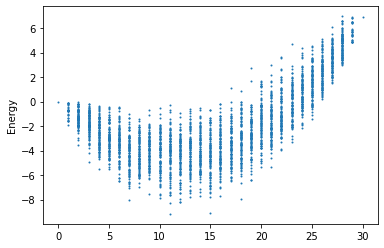

Best found: [0, 1, 5, 6, 7, 8, 10, 14, 19, 20, 22]
count: 11
Energy: -9.16372
Solutions Sampled: 2762


In [50]:
sup_list=ProbabilisticSampler(Ms,100)

In [51]:
print(sup_list[0])
print('count', len(sup_list[0]))
print('energy', sup_list[1])

[0, 1, 5, 6, 7, 8, 10, 14, 19, 20, 22]
count 11
energy -9.16372


In [52]:
# find products available at the suppliers
a=availability(sup_list[0],Ma)


In [53]:
print(len(a),a)

44 [ 0  1  2  3  5  9 14 16 17 22 24 25 29 30 32 33 34 35 36 37 38 39 40 41
 42 44 45 46 47 48 49 50 51 52 53 55 66 69 70 74 76 77 78 79]


In [54]:
m_i=item_m(a, Mi)

In [55]:
print(np.shape(m_i))
print(m_i)

(44, 44)
[[-0.6   0.7   0.03 ...  0.02  0.01  0.03]
 [ 0.   -0.91  0.02 ...  0.03  0.04  0.  ]
 [ 0.    0.   -0.92 ...  0.01  0.02  0.04]
 ...
 [ 0.    0.    0.   ... -0.39  0.7   0.02]
 [ 0.    0.    0.   ...  0.    0.2  -0.9 ]
 [ 0.    0.    0.   ...  0.    0.   -0.34]]


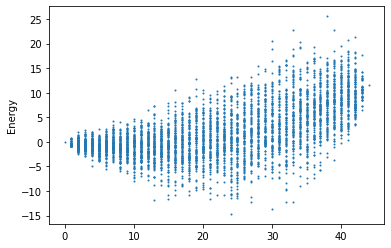

Best found: [0, 2, 3, 4, 5, 6, 9, 11, 12, 16, 21, 22, 23, 25, 30, 33, 34, 35, 36, 37, 38, 41, 42, 43]
count: 24
Energy: -14.67000000000007
Solutions Sampled: 4190


In [56]:
p_items=ProbabilisticSampler(m_i,100)

In [57]:
print(p_items[0])
print('count', len(p_items[0]))
print('energy', p_items[1])

[0, 2, 3, 4, 5, 6, 9, 11, 12, 16, 21, 22, 23, 25, 30, 33, 34, 35, 36, 37, 38, 41, 42, 43]
count 24
energy -14.67000000000007


#### Plotting resuls for both Scenario A and B

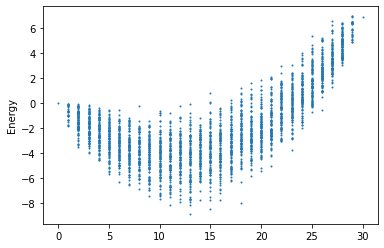

Best found: [4, 5, 6, 7, 9, 11, 12, 14, 20, 21, 22, 23, 26]
count: 13
Energy: -8.90142
Solutions Sampled: 2762
Ideal suppliers: [4, 5, 6, 7, 9, 11, 12, 14, 20, 21, 22, 23, 26]
Supplier energy -8.90142
Items available: 51 [ 0  1  2  3  5  6  8  9 13 15 16 17 18 20 22 23 24 25 27 28 30 32 35 37
 38 39 40 41 42 44 45 46 47 48 49 50 51 54 55 57 58 59 62 63 68 72 74 75
 76 77 79]
(51, 51)


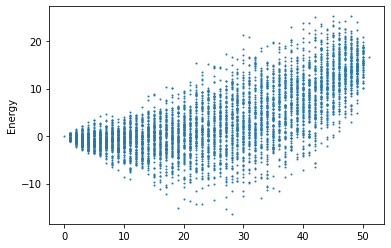

Best found: [0, 3, 4, 5, 6, 8, 9, 10, 17, 22, 23, 24, 26, 27, 28, 29, 31, 33, 38, 39, 40, 43, 44, 45, 46, 47, 48, 49]
count: 28
Energy: -16.370000000000072
Solutions Sampled: 4904
Items in solution: [ 0.  3.  5.  6.  8. 13. 15. 16. 25. 35. 37. 38. 40. 41. 42. 44. 46. 48.
 55. 57. 58. 63. 68. 72. 74. 75. 76. 77.]
Item Energy -16.370000000000072


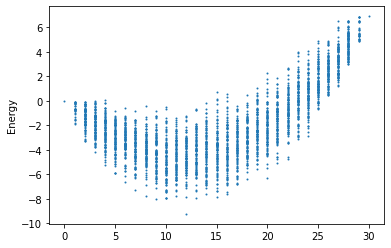

Best found: [0, 5, 6, 7, 8, 9, 11, 12, 14, 21, 23, 26]
count: 12
Energy: -9.218840000000002
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 6, 7, 8, 9, 11, 12, 14, 21, 23, 26]
Supplier energy -9.218840000000002
Items available: 56 [ 0  1  2  3  5  6  8 13 15 16 17 18 20 22 23 24 25 27 28 29 30 32 33 34
 35 36 37 38 39 40 41 42 44 45 46 47 48 50 51 52 53 54 55 57 58 63 68 69
 70 72 74 75 76 77 78 79]
(56, 56)


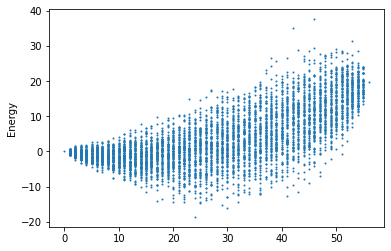

Best found: [1, 4, 5, 7, 8, 15, 17, 21, 26, 28, 29, 30, 32, 35, 36, 42, 43, 44, 45, 47, 48, 49, 51, 52]
count: 24
Energy: -18.630000000000052
Solutions Sampled: 5414
Items in solution: [ 1.  5.  6. 13. 15. 24. 27. 32. 37. 39. 40. 41. 44. 47. 48. 55. 57. 58.
 63. 69. 70. 72. 75. 76.]
Item Energy -18.630000000000052


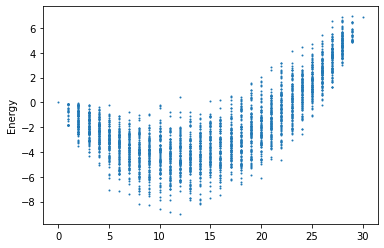

Best found: [0, 4, 6, 7, 9, 10, 14, 19, 20, 26, 27, 28]
count: 12
Energy: -8.997009999999998
Solutions Sampled: 2762
Ideal suppliers: [0, 4, 6, 7, 9, 10, 14, 19, 20, 26, 27, 28]
Supplier energy -8.997009999999998
Items available: 48 [ 0  1  2  3  5  9 11 16 17 22 24 25 28 29 30 31 32 35 36 38 39 40 41 42
 44 45 46 47 48 49 50 51 52 53 55 57 58 59 62 63 66 69 70 74 75 76 77 79]
(48, 48)


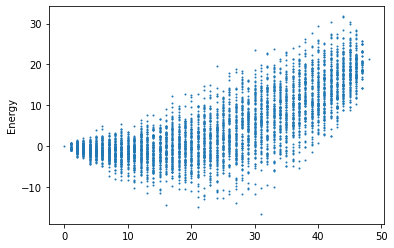

Best found: [0, 2, 3, 4, 5, 6, 11, 14, 16, 19, 20, 21, 22, 23, 24, 25, 26, 27, 31, 35, 36, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47]
count: 31
Energy: -16.560000000000084
Solutions Sampled: 4598
Items in solution: [ 0.  2.  3.  5.  9. 11. 25. 30. 32. 38. 39. 40. 41. 42. 44. 45. 46. 47.
 51. 57. 58. 62. 63. 66. 69. 70. 74. 75. 76. 77. 79.]
Item Energy -16.560000000000084


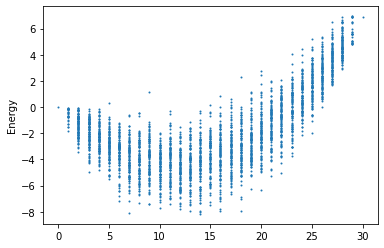

Best found: [0, 6, 7, 9, 10, 11, 14, 17, 19, 20, 21, 24, 27, 29]
count: 14
Energy: -8.159839999999997
Solutions Sampled: 2762
Ideal suppliers: [0, 6, 7, 9, 10, 11, 14, 17, 19, 20, 21, 24, 27, 29]
Supplier energy -8.159839999999997
Items available: 55 [ 0  1  2  3  4  5  7  8  9 10 11 13 15 16 17 18 20 22 23 25 27 29 30 32
 35 36 38 39 40 41 42 44 45 46 47 48 50 51 52 53 55 56 57 58 60 65 66 69
 70 73 74 75 76 77 79]
(55, 55)


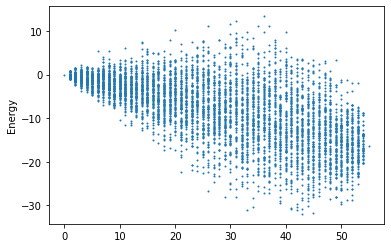

Best found: [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 14, 15, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 31, 33, 34, 36, 37, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 54]
count: 43
Energy: -31.94999999999989
Solutions Sampled: 5312
Items in solution: [ 0.  1.  2.  3.  4.  5.  7.  9. 10. 11. 13. 15. 17. 18. 22. 23. 25. 27.
 29. 32. 35. 36. 38. 39. 40. 41. 44. 46. 47. 50. 51. 55. 56. 57. 58. 60.
 65. 66. 69. 70. 73. 74. 79.]
Item Energy -31.94999999999989


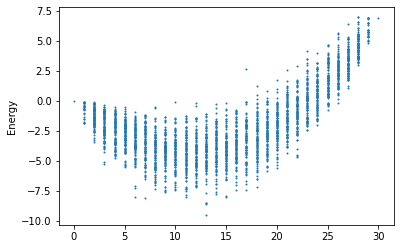

Best found: [0, 3, 5, 6, 7, 8, 9, 14, 15, 20, 21, 26, 29]
count: 13
Energy: -9.516150000000003
Solutions Sampled: 2762
Ideal suppliers: [0, 3, 5, 6, 7, 8, 9, 14, 15, 20, 21, 26, 29]
Supplier energy -9.516150000000003
Items available: 54 [ 1  5  8  9 13 15 16 17 18 20 22 23 24 25 27 28 29 30 32 33 34 35 36 37
 38 39 40 41 42 44 45 46 47 48 50 51 52 53 55 57 58 59 60 61 63 65 69 70
 74 75 76 77 78 79]
(54, 54)


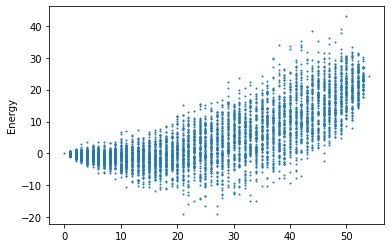

Best found: [0, 3, 4, 5, 9, 10, 11, 13, 17, 20, 24, 25, 26, 27, 30, 32, 35, 38, 39, 40, 42, 44, 46, 47, 48, 49, 50]
count: 27
Energy: -18.990000000000084
Solutions Sampled: 5210
Items in solution: [ 1.  9. 13. 15. 20. 22. 23. 25. 30. 34. 38. 39. 40. 41. 45. 47. 51. 55.
 57. 58. 60. 63. 69. 70. 74. 75. 76.]
Item Energy -18.990000000000084


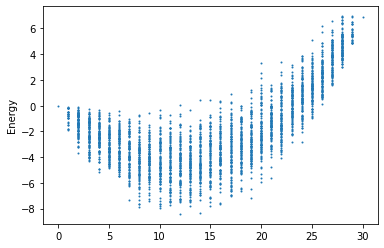

Best found: [2, 5, 6, 7, 8, 11, 14, 17, 20, 24, 27, 28]
count: 12
Energy: -8.412789999999998
Solutions Sampled: 2762
Ideal suppliers: [2, 5, 6, 7, 8, 11, 14, 17, 20, 24, 27, 28]
Supplier energy -8.412789999999998
Items available: 44 [ 0  1  2  3  4  5  7  9 10 11 14 16 17 22 24 25 26 29 30 31 32 33 34 35
 36 37 38 39 40 42 44 45 46 48 49 50 51 56 73 74 76 77 78 79]
(44, 44)


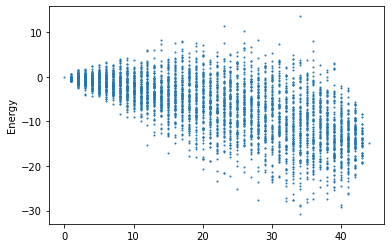

Best found: [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15, 16, 17, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 33, 34, 37, 39, 40, 41, 42, 43]
count: 34
Energy: -30.749999999999957
Solutions Sampled: 4190
Items in solution: [ 0.  2.  3.  4.  5.  7.  9. 10. 11. 14. 17. 24. 25. 26. 29. 32. 33. 34.
 35. 36. 37. 39. 40. 42. 44. 45. 48. 49. 56. 74. 76. 77. 78. 79.]
Item Energy -30.749999999999957


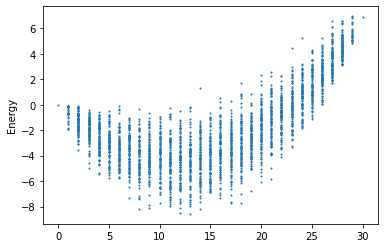

Best found: [2, 5, 6, 7, 9, 10, 11, 13, 14, 18, 20, 24, 27]
count: 13
Energy: -8.572549999999998
Solutions Sampled: 2762
Ideal suppliers: [2, 5, 6, 7, 9, 10, 11, 13, 14, 18, 20, 24, 27]
Supplier energy -8.572549999999998
Items available: 46 [ 0  1  2  3  5  6  9 10 11 12 14 16 17 18 20 21 22 25 26 30 32 35 36 37
 38 39 40 42 44 45 46 48 50 51 55 57 58 64 66 71 73 74 75 76 77 79]
(46, 46)


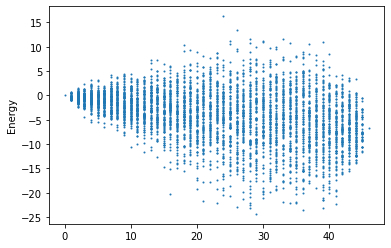

Best found: [0, 2, 4, 6, 7, 8, 9, 12, 16, 17, 18, 20, 22, 24, 25, 26, 27, 28, 29, 32, 33, 34, 35, 36, 39, 40, 41, 42, 45]
count: 29
Energy: -24.340000000000057
Solutions Sampled: 4394
Items in solution: [ 0.  2.  5.  9. 10. 11. 12. 17. 22. 25. 26. 32. 36. 38. 39. 40. 42. 44.
 45. 50. 51. 55. 57. 58. 71. 73. 74. 75. 79.]
Item Energy -24.340000000000057


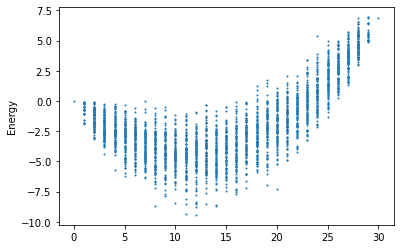

Best found: [4, 5, 7, 8, 9, 10, 11, 14, 20, 21, 27, 29]
count: 12
Energy: -9.43159
Solutions Sampled: 2762
Ideal suppliers: [4, 5, 7, 8, 9, 10, 11, 14, 20, 21, 27, 29]
Supplier energy -9.43159
Items available: 49 [ 0  2  3  5  8  9 11 13 15 16 17 18 20 22 23 24 25 27 29 30 32 33 34 35
 37 38 39 40 42 44 45 46 48 50 51 55 57 58 59 60 62 65 66 74 75 76 77 78
 79]
(49, 49)


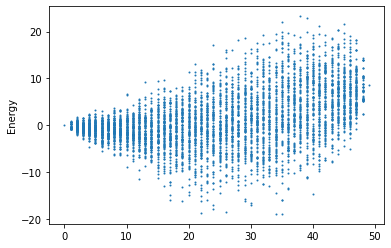

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 14, 16, 17, 22, 23, 24, 25, 26, 27, 28, 30, 36, 37, 38, 39, 41, 42, 44, 45, 46, 47, 48]
count: 34
Energy: -18.97999999999992
Solutions Sampled: 4700
Items in solution: [ 0.  2.  3.  5.  8.  9. 11. 13. 15. 17. 18. 20. 23. 25. 27. 34. 35. 37.
 38. 39. 40. 42. 45. 57. 58. 59. 60. 65. 66. 75. 76. 77. 78. 79.]
Item Energy -18.97999999999992


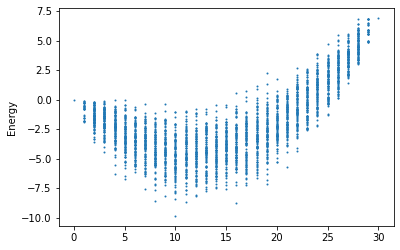

Best found: [4, 5, 6, 7, 10, 11, 14, 19, 20, 23]
count: 10
Energy: -9.82674
Solutions Sampled: 2762
Ideal suppliers: [4, 5, 6, 7, 10, 11, 14, 19, 20, 23]
Supplier energy -9.82674
Items available: 35 [ 0  1  2  3  5  6  8  9 13 16 17 18 20 22 25 35 38 39 40 42 44 45 46 48
 50 51 59 62 66 68 72 74 76 77 79]
(35, 35)


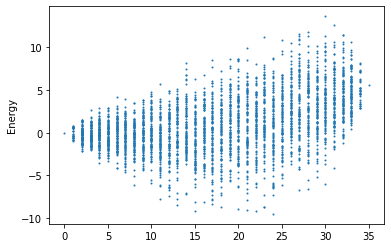

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 10, 12, 14, 16, 17, 18, 19, 22, 23, 24, 28, 29, 31, 32, 33, 34]
count: 24
Energy: -9.490000000000052
Solutions Sampled: 3272
Items in solution: [ 1.  2.  3.  5.  6.  8.  9. 13. 17. 20. 25. 38. 39. 40. 42. 46. 48. 50.
 66. 68. 74. 76. 77. 79.]
Item Energy -9.490000000000052


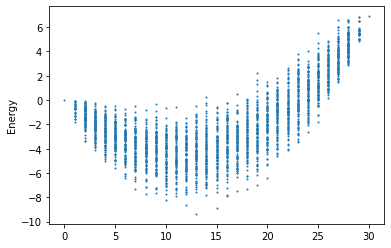

Best found: [0, 4, 5, 7, 8, 9, 11, 12, 13, 14, 20, 23, 28]
count: 13
Energy: -9.36812
Solutions Sampled: 2762
Ideal suppliers: [0, 4, 5, 7, 8, 9, 11, 12, 13, 14, 20, 23, 28]
Supplier energy -9.36812
Items available: 55 [ 0  2  3  5  6  8  9 13 16 17 18 20 22 24 25 29 30 31 32 33 34 35 36 37
 38 39 40 41 42 44 45 46 47 48 49 50 51 52 53 54 55 57 58 59 62 68 69 70
 72 74 75 76 77 78 79]
(55, 55)


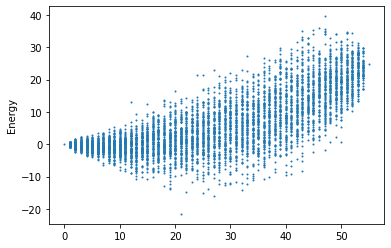

Best found: [1, 3, 4, 5, 7, 13, 14, 18, 20, 24, 25, 28, 29, 31, 41, 42, 46, 47, 50, 52, 54]
count: 21
Energy: -21.55000000000004
Solutions Sampled: 5312
Items in solution: [ 2.  5.  6.  8. 13. 24. 25. 32. 34. 38. 39. 42. 44. 46. 57. 58. 69. 70.
 75. 77. 79.]
Item Energy -21.55000000000004


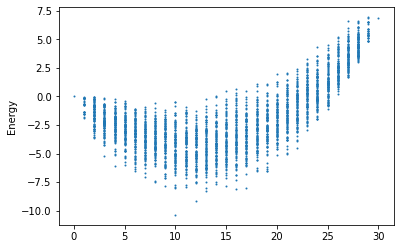

Best found: [5, 6, 7, 10, 11, 14, 20, 21, 27, 28]
count: 10
Energy: -10.37848
Solutions Sampled: 2762
Ideal suppliers: [5, 6, 7, 10, 11, 14, 20, 21, 27, 28]
Supplier energy -10.37848
Items available: 37 [ 0  1  2  3  5  8  9 11 13 15 16 17 18 20 22 23 25 27 31 32 35 38 39 40
 42 44 45 46 48 49 50 51 66 74 76 77 79]
(37, 37)


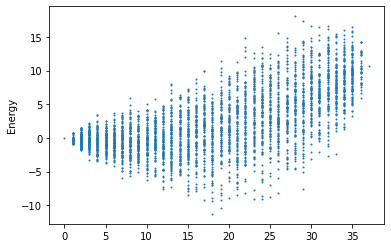

Best found: [0, 2, 3, 4, 5, 8, 13, 14, 16, 21, 22, 23, 24, 25, 32, 34, 35, 36]
count: 18
Energy: -11.290000000000028
Solutions Sampled: 3476
Items in solution: [ 0.  2.  3.  5.  8. 13. 20. 22. 25. 38. 39. 40. 42. 44. 66. 76. 77. 79.]
Item Energy -11.290000000000028


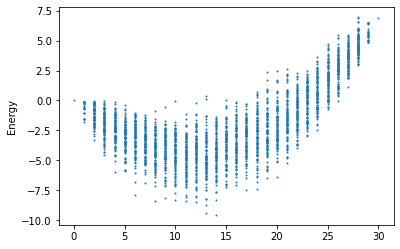

Best found: [0, 5, 6, 7, 10, 11, 14, 15, 19, 20, 22, 26, 27, 28]
count: 14
Energy: -9.563119999999998
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 6, 7, 10, 11, 14, 15, 19, 20, 22, 26, 27, 28]
Supplier energy -9.563119999999998
Items available: 45 [ 0  1  2  3  5  9 11 16 17 22 24 25 28 29 31 32 35 36 37 38 39 40 41 42
 44 45 46 47 48 49 50 51 52 53 55 57 58 63 66 69 70 74 76 77 79]
(45, 45)


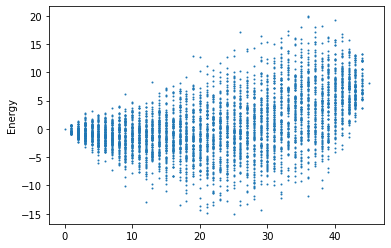

Best found: [1, 2, 3, 4, 5, 6, 8, 11, 14, 18, 19, 20, 21, 22, 23, 26, 27, 29, 30, 33, 34, 35, 39, 41, 43]
count: 25
Energy: -15.040000000000068
Solutions Sampled: 4291
Items in solution: [ 1.  2.  3.  5.  9. 11. 17. 25. 31. 37. 38. 39. 40. 41. 42. 46. 47. 49.
 50. 53. 55. 57. 69. 74. 77.]
Item Energy -15.040000000000068


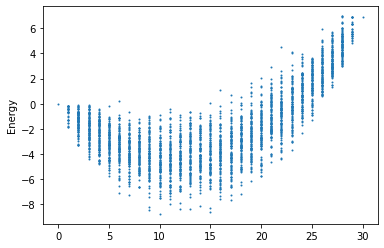

Best found: [2, 5, 6, 7, 8, 11, 14, 20, 25, 26]
count: 10
Energy: -8.78436
Solutions Sampled: 2762
Ideal suppliers: [2, 5, 6, 7, 8, 11, 14, 20, 25, 26]
Supplier energy -8.78436
Items available: 46 [ 0  1  2  5  9 14 16 17 22 24 25 26 28 29 30 32 33 34 35 36 37 38 39 40
 42 44 45 46 48 50 51 52 55 57 58 60 63 65 67 70 74 75 76 77 78 79]
(46, 46)


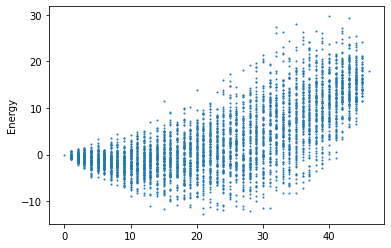

Best found: [0, 2, 4, 5, 10, 11, 15, 16, 17, 18, 20, 21, 22, 24, 27, 28, 29, 30, 31, 36, 39]
count: 21
Energy: -12.730000000000038
Solutions Sampled: 4394
Items in solution: [ 0.  2.  9. 14. 25. 26. 32. 33. 34. 35. 37. 38. 39. 42. 46. 48. 50. 51.
 52. 63. 70.]
Item Energy -12.730000000000038


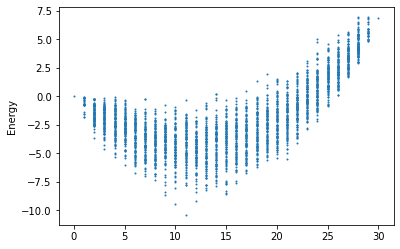

Best found: [5, 6, 7, 8, 10, 11, 13, 14, 20, 27, 28]
count: 11
Energy: -10.40439
Solutions Sampled: 2762
Ideal suppliers: [5, 6, 7, 8, 10, 11, 13, 14, 20, 27, 28]
Supplier energy -10.40439
Items available: 37 [ 0  1  2  3  5  9 11 16 17 22 24 25 29 30 31 32 33 34 35 37 38 39 40 42
 44 45 46 48 49 50 51 66 74 76 77 78 79]
(37, 37)


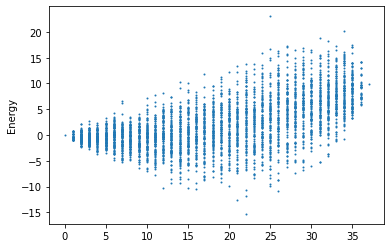

Best found: [1, 2, 3, 4, 5, 6, 7, 9, 11, 15, 16, 19, 20, 21, 22, 23, 27, 28, 31, 33, 34, 36]
count: 22
Energy: -15.320000000000052
Solutions Sampled: 3476
Items in solution: [ 1.  2.  3.  5.  9. 11. 16. 22. 25. 32. 33. 37. 38. 39. 40. 42. 48. 49.
 66. 76. 77. 79.]
Item Energy -15.320000000000052


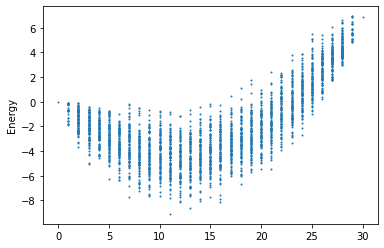

Best found: [0, 4, 7, 8, 9, 10, 11, 14, 20, 26, 29]
count: 11
Energy: -9.091510000000003
Solutions Sampled: 2762
Ideal suppliers: [0, 4, 7, 8, 9, 10, 11, 14, 20, 26, 29]
Supplier energy -9.091510000000003
Items available: 49 [ 0  2  3  5  9 16 17 22 24 25 28 29 30 32 33 34 35 36 37 38 39 40 41 42
 44 45 46 47 48 50 51 52 53 55 57 58 59 60 62 63 65 66 69 70 74 75 76 78
 79]
(49, 49)


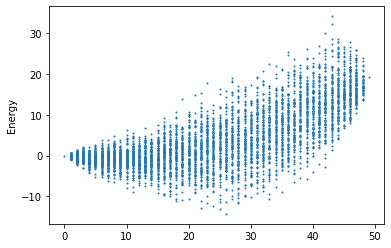

Best found: [0, 1, 4, 6, 7, 9, 13, 15, 16, 17, 18, 20, 21, 27, 28, 32, 33, 34, 35, 38, 39, 41, 42, 43, 44, 45]
count: 26
Energy: -14.300000000000022
Solutions Sampled: 4700
Items in solution: [ 0.  2.  9. 17. 22. 25. 32. 34. 35. 36. 37. 39. 40. 47. 48. 53. 55. 57.
 58. 62. 63. 66. 69. 70. 74. 75.]
Item Energy -14.300000000000022


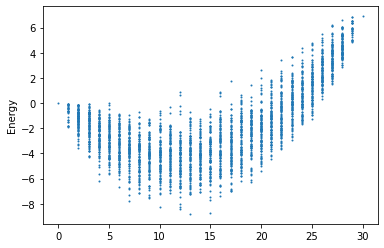

Best found: [0, 2, 5, 7, 8, 9, 11, 12, 13, 14, 15, 20, 29]
count: 13
Energy: -8.80615
Solutions Sampled: 2762
Ideal suppliers: [0, 2, 5, 7, 8, 9, 11, 12, 13, 14, 15, 20, 29]
Supplier energy -8.80615
Items available: 47 [ 0  2  5  9 14 16 17 22 24 25 26 29 30 32 33 34 35 36 37 38 39 40 41 42
 44 45 46 47 48 50 51 52 53 54 55 57 58 60 65 69 70 74 75 76 77 78 79]
(47, 47)


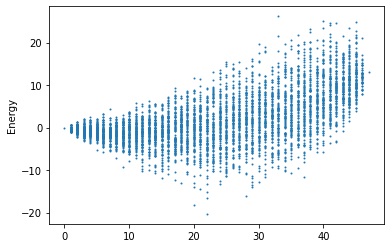

Best found: [1, 2, 3, 9, 10, 13, 15, 18, 19, 21, 28, 29, 34, 35, 39, 40, 41, 42, 43, 44, 45, 46]
count: 22
Energy: -20.30000000000005
Solutions Sampled: 4496
Items in solution: [ 2.  5.  9. 25. 26. 32. 34. 37. 38. 40. 48. 50. 55. 57. 69. 70. 74. 75.
 76. 77. 78. 79.]
Item Energy -20.30000000000005


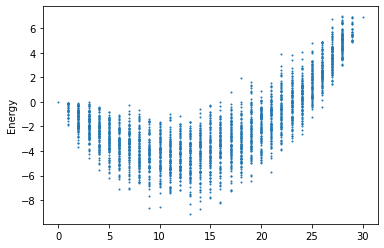

Best found: [0, 2, 5, 7, 9, 10, 11, 14, 15, 19, 20, 23, 29]
count: 13
Energy: -9.123606
Solutions Sampled: 2762
Ideal suppliers: [0, 2, 5, 7, 9, 10, 11, 14, 15, 19, 20, 23, 29]
Supplier energy -9.123606
Items available: 52 [ 0  2  3  5  6  8  9 13 14 16 17 18 20 22 24 25 26 29 30 32 35 36 37 38
 39 40 41 42 44 45 46 47 48 50 51 52 53 55 57 58 60 65 66 68 69 70 72 74
 75 76 77 79]
(52, 52)


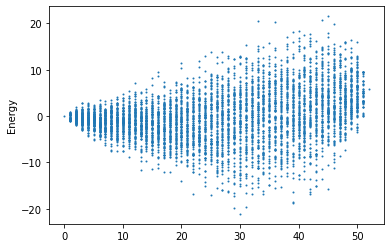

Best found: [1, 3, 4, 5, 7, 8, 12, 13, 16, 21, 23, 24, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 41, 42, 44, 45, 46, 47, 49, 50]
count: 30
Energy: -21.12000000000009
Solutions Sampled: 5006
Items in solution: [ 2.  5.  6.  8. 13. 14. 20. 22. 26. 36. 38. 39. 41. 42. 48. 50. 51. 52.
 53. 55. 57. 58. 65. 66. 69. 70. 72. 74. 76. 77.]
Item Energy -21.12000000000009


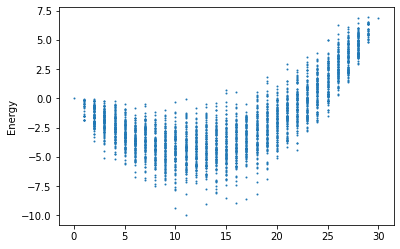

Best found: [0, 6, 7, 8, 10, 11, 12, 14, 15, 20, 21]
count: 11
Energy: -9.96078
Solutions Sampled: 2762
Ideal suppliers: [0, 6, 7, 8, 10, 11, 12, 14, 15, 20, 21]
Supplier energy -9.96078
Items available: 50 [ 0  1  2  3  5  8  9 13 15 16 17 18 20 22 23 24 25 27 29 30 32 33 34 35
 36 37 38 39 40 41 42 44 45 46 47 48 50 51 52 53 54 55 66 69 70 74 76 77
 78 79]
(50, 50)


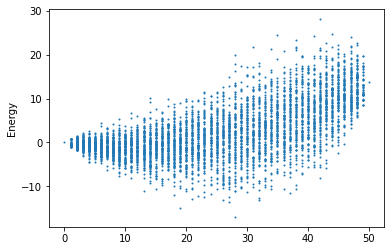

Best found: [1, 2, 3, 4, 5, 6, 7, 8, 10, 13, 14, 17, 23, 24, 25, 26, 27, 29, 30, 31, 35, 36, 38, 43, 44, 47, 48, 49]
count: 28
Energy: -16.96000000000009
Solutions Sampled: 4802
Items in solution: [ 1.  2.  3.  5.  8.  9. 13. 15. 17. 22. 23. 27. 35. 36. 37. 38. 39. 41.
 42. 44. 48. 50. 52. 69. 70. 77. 78. 79.]
Item Energy -16.96000000000009


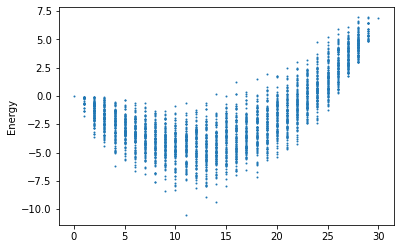

Best found: [0, 1, 5, 6, 7, 8, 10, 11, 14, 20, 23]
count: 11
Energy: -10.50482
Solutions Sampled: 2762
Ideal suppliers: [0, 1, 5, 6, 7, 8, 10, 11, 14, 20, 23]
Supplier energy -10.50482
Items available: 50 [ 0  1  2  3  5  6  8  9 13 14 16 17 18 20 22 24 25 29 30 32 33 34 35 36
 37 38 39 40 41 42 44 45 46 47 48 50 51 52 53 55 66 68 69 70 72 74 76 77
 78 79]
(50, 50)


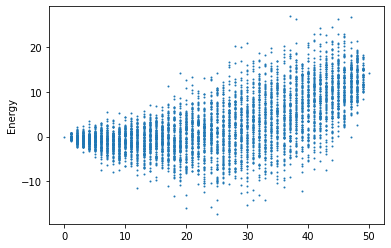

Best found: [2, 3, 7, 8, 9, 13, 16, 19, 21, 23, 24, 25, 26, 27, 29, 30, 32, 33, 34, 37, 39, 42, 43, 46, 49]
count: 25
Energy: -17.320000000000086
Solutions Sampled: 4802
Items in solution: [ 2.  3.  9. 13. 14. 20. 25. 32. 34. 36. 37. 38. 39. 40. 42. 44. 46. 47.
 48. 52. 55. 69. 70. 76. 79.]
Item Energy -17.320000000000086


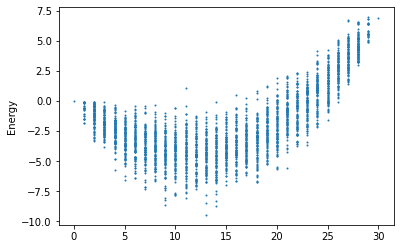

Best found: [0, 5, 6, 8, 10, 11, 14, 15, 19, 20, 21, 24, 26]
count: 13
Energy: -9.493779999999996
Solutions Sampled: 2762
Ideal suppliers: [0, 5, 6, 8, 10, 11, 14, 15, 19, 20, 21, 24, 26]
Supplier energy -9.493779999999996
Items available: 52 [ 0  1  2  3  5  8  9 13 15 17 18 20 22 23 24 25 27 28 29 30 32 33 34 35
 36 37 38 39 41 42 44 45 46 47 48 50 51 52 53 55 57 58 63 66 69 70 73 74
 76 77 78 79]
(52, 52)


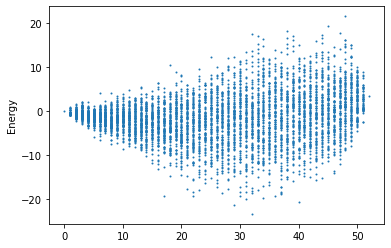

Best found: [2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15, 16, 20, 21, 22, 25, 27, 29, 34, 35, 38, 40, 42, 43, 44, 46, 47, 48, 49, 50, 51]
count: 32
Energy: -23.409999999999986
Solutions Sampled: 5006
Items in solution: [ 2.  3.  5.  8.  9. 13. 15. 17. 22. 23. 24. 25. 27. 32. 33. 34. 37. 39.
 42. 48. 50. 53. 57. 63. 66. 69. 73. 74. 76. 77. 78. 79.]
Item Energy -23.409999999999986


In [58]:
# Scenario A - Plotting
plot_sup1=[]
plot_prod1=[]

total=20
for trials in range(total):

    sup_list=ProbabilisticSampler(Ms,100)
    print('Ideal suppliers:',sup_list[0])
    #print('count', len(sup_list[0]))
    print('Supplier energy', sup_list[1])
    plot_sup1.append(sup_list[1])
    a=availability(sup_list[0],Ma)
    print('Items available:',len(a),a)
    m_i=item_m(a, Mi)
    print(np.shape(m_i))
    p_items=ProbabilisticSampler(m_i,100)
    i_item=np.zeros(len(p_items[0]))
    for i in range(len(p_items[0])):
        i_item[i]=a[p_items[0][i]]
    print('Items in solution:',i_item)
    #print('count', len(p_items[0]))
    print('Item Energy', p_items[1])
    plot_prod1.append(p_items[1])
    


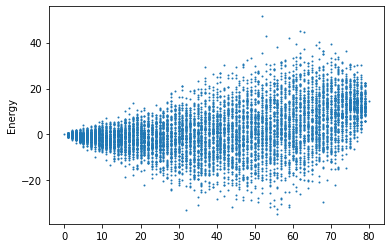

Best found: [0, 1, 2, 3, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 21, 23, 24, 26, 27, 29, 30, 32, 36, 37, 38, 39, 40, 41, 42, 43, 45, 46, 47, 49, 50, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 64, 66, 67, 69, 70, 71, 72, 73, 77]
count: 56
Energy: -34.67999999999963
Solutions Sampled: 7862
Ideal items: [0, 1, 2, 3, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 21, 23, 24, 26, 27, 29, 30, 32, 36, 37, 38, 39, 40, 41, 42, 43, 45, 46, 47, 49, 50, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 64, 66, 67, 69, 70, 71, 72, 73, 77]
Items energy: -34.67999999999963
max random 30


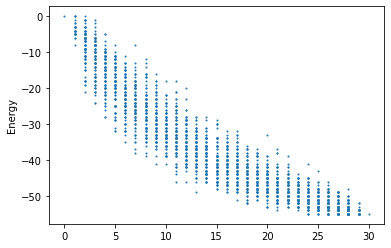

Best found: [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 27, 28, 29]
count: 24
Energy: -55.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 27, 28, 29]
Supplier Energy -0.8652599999999975


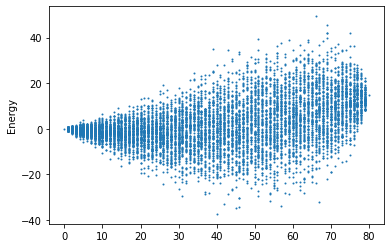

Best found: [5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 20, 23, 24, 25, 26, 27, 28, 34, 39, 41, 42, 43, 47, 48, 49, 50, 54, 56, 57, 65, 66, 67, 69, 70, 71, 72, 73, 74, 76]
count: 40
Energy: -37.359999999999815
Solutions Sampled: 7862
Ideal items: [5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 20, 23, 24, 25, 26, 27, 28, 34, 39, 41, 42, 43, 47, 48, 49, 50, 54, 56, 57, 65, 66, 67, 69, 70, 71, 72, 73, 74, 76]
Items energy: -37.359999999999815
max random 30


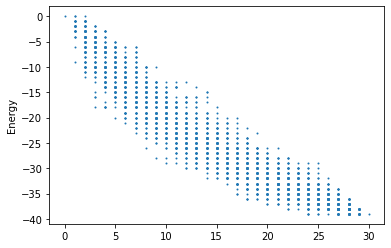

Best found: [0, 2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
count: 24
Energy: -39.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
Supplier Energy -0.3431510000000004


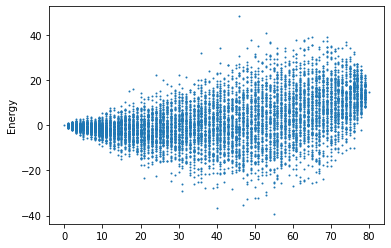

Best found: [0, 3, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 20, 21, 23, 24, 25, 26, 29, 33, 34, 36, 39, 40, 42, 43, 44, 46, 47, 48, 49, 51, 52, 53, 54, 55, 56, 57, 58, 60, 61, 62, 63, 64, 65, 66, 67, 69, 70, 71, 72, 75, 78]
count: 55
Energy: -39.25999999999932
Solutions Sampled: 7862
Ideal items: [0, 3, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 20, 21, 23, 24, 25, 26, 29, 33, 34, 36, 39, 40, 42, 43, 44, 46, 47, 48, 49, 51, 52, 53, 54, 55, 56, 57, 58, 60, 61, 62, 63, 64, 65, 66, 67, 69, 70, 71, 72, 75, 78]
Items energy: -39.25999999999932
max random 30


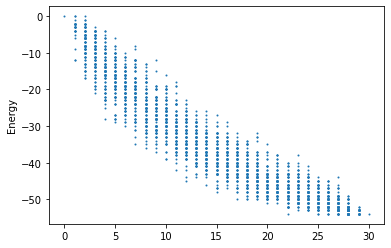

Best found: [0, 2, 3, 4, 6, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 25, 27, 28]
count: 22
Energy: -54.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 6, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 25, 27, 28]
Supplier Energy -0.12126599999999788


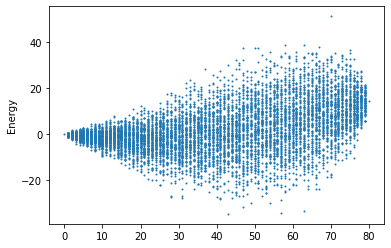

Best found: [2, 4, 5, 6, 7, 9, 12, 13, 18, 19, 21, 22, 24, 26, 28, 33, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 50, 52, 55, 56, 57, 58, 59, 60, 62, 64, 69, 70, 72, 73, 74, 76, 78]
count: 43
Energy: -34.54999999999988
Solutions Sampled: 7862
Ideal items: [2, 4, 5, 6, 7, 9, 12, 13, 18, 19, 21, 22, 24, 26, 28, 33, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 50, 52, 55, 56, 57, 58, 59, 60, 62, 64, 69, 70, 72, 73, 74, 76, 78]
Items energy: -34.54999999999988
max random 30


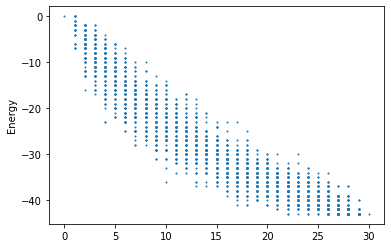

Best found: [0, 2, 3, 4, 8, 9, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29]
count: 22
Energy: -43.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 8, 9, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29]
Supplier Energy 1.6596040000000007


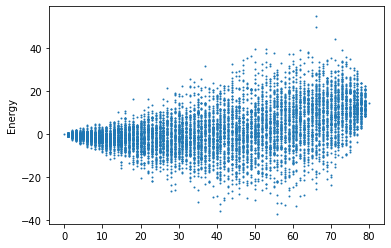

Best found: [1, 2, 5, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 29, 32, 34, 35, 37, 38, 39, 42, 43, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78]
count: 56
Energy: -37.15999999999959
Solutions Sampled: 7862
Ideal items: [1, 2, 5, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 29, 32, 34, 35, 37, 38, 39, 42, 43, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78]
Items energy: -37.15999999999959
max random 30


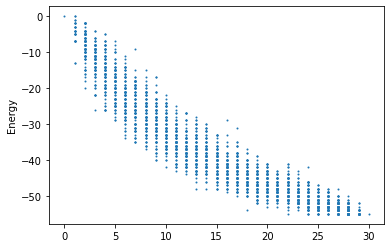

Best found: [0, 1, 2, 3, 4, 6, 8, 10, 12, 14, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29]
count: 22
Energy: -55.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 6, 8, 10, 12, 14, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29]
Supplier Energy 0.817904000000001


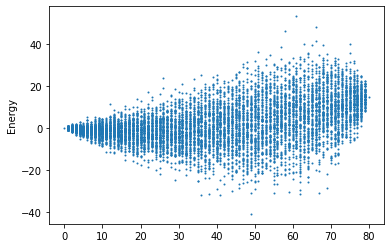

Best found: [1, 3, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 22, 23, 26, 28, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 50, 52, 53, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 69, 70, 71, 72, 73, 74, 78, 79]
count: 49
Energy: -41.01999999999973
Solutions Sampled: 7862
Ideal items: [1, 3, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 22, 23, 26, 28, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 50, 52, 53, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 69, 70, 71, 72, 73, 74, 78, 79]
Items energy: -41.01999999999973
max random 30


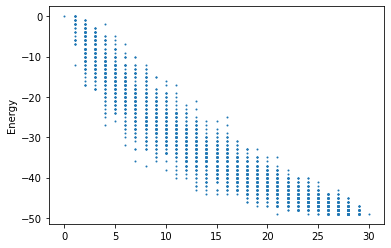

Best found: [0, 1, 2, 3, 4, 6, 7, 8, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
count: 21
Energy: -49.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 6, 7, 8, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
Supplier Energy -1.9160609999999987


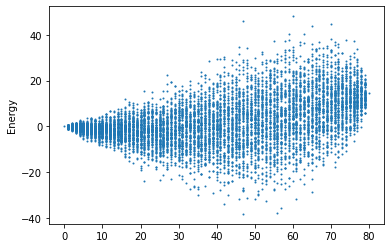

Best found: [0, 5, 7, 8, 10, 11, 12, 13, 14, 15, 17, 19, 20, 23, 24, 28, 32, 34, 37, 38, 39, 41, 44, 45, 48, 50, 51, 52, 53, 54, 55, 56, 57, 62, 63, 66, 67, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
count: 47
Energy: -38.3399999999997
Solutions Sampled: 7862
Ideal items: [0, 5, 7, 8, 10, 11, 12, 13, 14, 15, 17, 19, 20, 23, 24, 28, 32, 34, 37, 38, 39, 41, 44, 45, 48, 50, 51, 52, 53, 54, 55, 56, 57, 62, 63, 66, 67, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Items energy: -38.3399999999997
max random 30


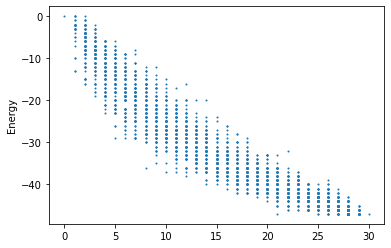

Best found: [0, 2, 3, 4, 5, 8, 10, 11, 12, 14, 15, 16, 17, 18, 21, 22, 23, 24, 25, 26, 27]
count: 21
Energy: -47.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 5, 8, 10, 11, 12, 14, 15, 16, 17, 18, 21, 22, 23, 24, 25, 26, 27]
Supplier Energy 0.20144900000000177


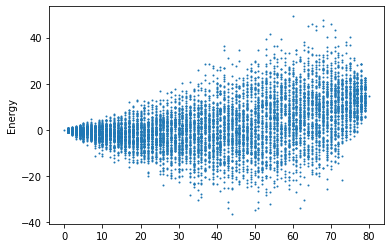

Best found: [0, 2, 4, 5, 7, 8, 9, 10, 11, 12, 14, 15, 17, 19, 20, 21, 23, 24, 25, 27, 28, 34, 38, 39, 40, 41, 45, 46, 48, 50, 52, 55, 56, 57, 59, 61, 67, 70, 71, 73, 74, 75, 76, 77]
count: 44
Energy: -36.339999999999755
Solutions Sampled: 7862
Ideal items: [0, 2, 4, 5, 7, 8, 9, 10, 11, 12, 14, 15, 17, 19, 20, 21, 23, 24, 25, 27, 28, 34, 38, 39, 40, 41, 45, 46, 48, 50, 52, 55, 56, 57, 59, 61, 67, 70, 71, 73, 74, 75, 76, 77]
Items energy: -36.339999999999755
max random 30


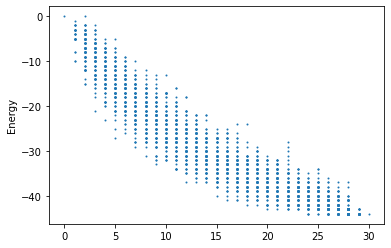

Best found: [0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27]
count: 24
Energy: -44.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27]
Supplier Energy 0.49682300000000024


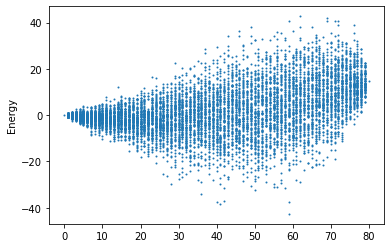

Best found: [0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 23, 24, 25, 26, 27, 28, 29, 30, 33, 34, 37, 38, 39, 41, 42, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 60, 62, 63, 65, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78]
count: 59
Energy: -42.69999999999919
Solutions Sampled: 7862
Ideal items: [0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 23, 24, 25, 26, 27, 28, 29, 30, 33, 34, 37, 38, 39, 41, 42, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 60, 62, 63, 65, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78]
Items energy: -42.69999999999919
max random 30


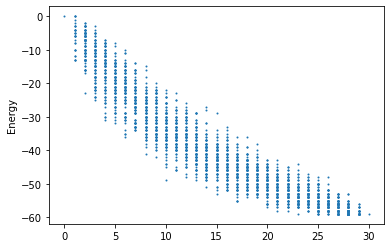

Best found: [0, 2, 3, 4, 6, 7, 8, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28]
count: 23
Energy: -59.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 6, 7, 8, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28]
Supplier Energy 0.26283300000000176


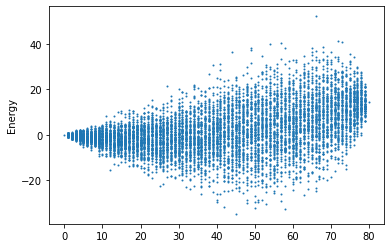

Best found: [1, 2, 3, 4, 5, 8, 9, 10, 11, 13, 14, 16, 17, 19, 25, 28, 29, 34, 36, 37, 39, 40, 41, 44, 46, 47, 48, 49, 50, 51, 53, 54, 55, 56, 57, 58, 60, 63, 71, 72, 73, 74, 75, 77, 79]
count: 45
Energy: -34.96999999999991
Solutions Sampled: 7862
Ideal items: [1, 2, 3, 4, 5, 8, 9, 10, 11, 13, 14, 16, 17, 19, 25, 28, 29, 34, 36, 37, 39, 40, 41, 44, 46, 47, 48, 49, 50, 51, 53, 54, 55, 56, 57, 58, 60, 63, 71, 72, 73, 74, 75, 77, 79]
Items energy: -34.96999999999991
max random 30


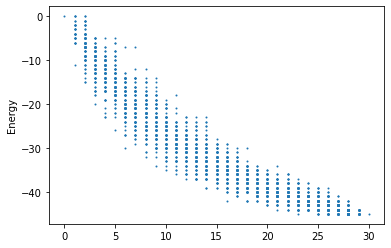

Best found: [0, 2, 3, 6, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 29]
count: 23
Energy: -45.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 6, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 29]
Supplier Energy 1.1045340000000001


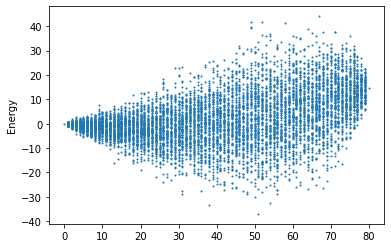

Best found: [1, 2, 3, 4, 7, 8, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 31, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 50, 52, 54, 55, 56, 57, 58, 59, 61, 62, 65, 67, 69, 70, 72, 74]
count: 51
Energy: -37.03999999999979
Solutions Sampled: 7862
Ideal items: [1, 2, 3, 4, 7, 8, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 31, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 50, 52, 54, 55, 56, 57, 58, 59, 61, 62, 65, 67, 69, 70, 72, 74]
Items energy: -37.03999999999979
max random 30


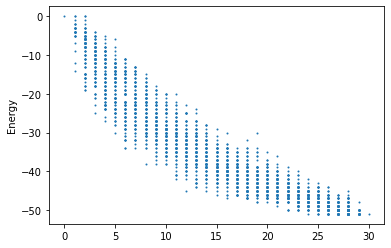

Best found: [0, 1, 2, 3, 4, 6, 7, 8, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 23, 25, 26, 27, 28]
count: 24
Energy: -51.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 6, 7, 8, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 23, 25, 26, 27, 28]
Supplier Energy 2.282853000000007


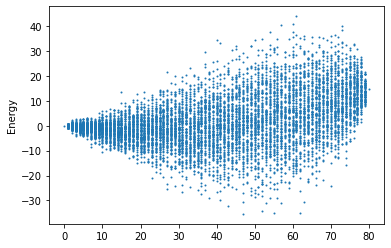

Best found: [3, 4, 5, 6, 7, 9, 10, 11, 13, 14, 16, 23, 25, 26, 27, 38, 39, 40, 42, 43, 44, 45, 46, 48, 49, 52, 54, 55, 56, 57, 61, 62, 63, 64, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
count: 47
Energy: -35.40999999999956
Solutions Sampled: 7862
Ideal items: [3, 4, 5, 6, 7, 9, 10, 11, 13, 14, 16, 23, 25, 26, 27, 38, 39, 40, 42, 43, 44, 45, 46, 48, 49, 52, 54, 55, 56, 57, 61, 62, 63, 64, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Items energy: -35.40999999999956
max random 30


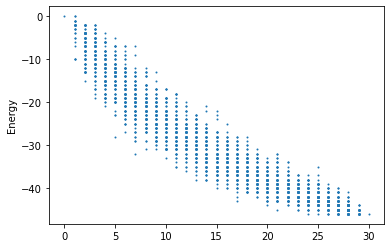

Best found: [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 24, 25, 27, 28, 29]
count: 24
Energy: -46.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 24, 25, 27, 28, 29]
Supplier Energy 0.4842640000000017


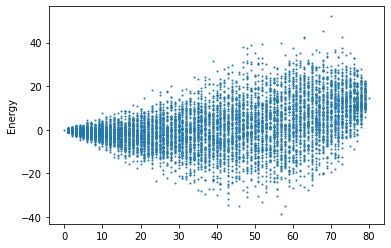

Best found: [0, 2, 3, 4, 5, 7, 9, 10, 11, 12, 13, 14, 17, 19, 20, 21, 25, 26, 27, 28, 29, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 48, 49, 50, 53, 55, 56, 57, 58, 60, 63, 64, 66, 68, 69, 70, 71, 73, 75, 76, 77, 79]
count: 57
Energy: -38.549999999999294
Solutions Sampled: 7862
Ideal items: [0, 2, 3, 4, 5, 7, 9, 10, 11, 12, 13, 14, 17, 19, 20, 21, 25, 26, 27, 28, 29, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 48, 49, 50, 53, 55, 56, 57, 58, 60, 63, 64, 66, 68, 69, 70, 71, 73, 75, 76, 77, 79]
Items energy: -38.549999999999294
max random 30


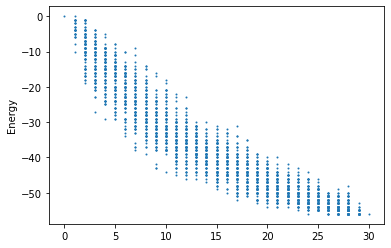

Best found: [0, 1, 2, 5, 6, 7, 8, 9, 10, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 29]
count: 24
Energy: -56.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 5, 6, 7, 8, 9, 10, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 29]
Supplier Energy -0.3062359999999974


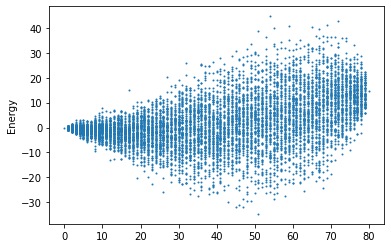

Best found: [2, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 19, 20, 23, 24, 26, 27, 29, 31, 33, 34, 35, 36, 38, 39, 40, 44, 45, 47, 51, 53, 54, 57, 58, 61, 62, 63, 66, 67, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
count: 51
Energy: -34.75999999999942
Solutions Sampled: 7862
Ideal items: [2, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 19, 20, 23, 24, 26, 27, 29, 31, 33, 34, 35, 36, 38, 39, 40, 44, 45, 47, 51, 53, 54, 57, 58, 61, 62, 63, 66, 67, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Items energy: -34.75999999999942
max random 30


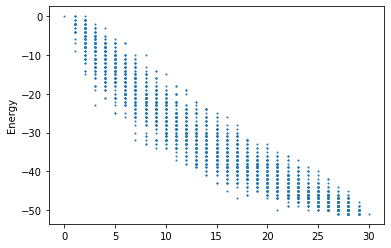

Best found: [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29]
count: 27
Energy: -51.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29]
Supplier Energy 4.40722400000001


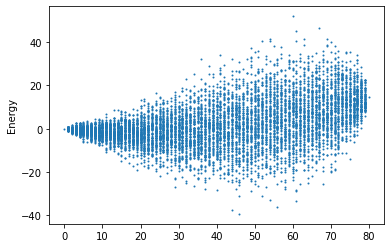

Best found: [1, 2, 5, 7, 8, 9, 10, 12, 13, 14, 15, 19, 21, 23, 24, 27, 30, 36, 37, 39, 40, 42, 45, 46, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 61, 62, 66, 67, 69, 70, 71, 72, 73, 76, 77, 79]
count: 46
Energy: -39.29999999999959
Solutions Sampled: 7862
Ideal items: [1, 2, 5, 7, 8, 9, 10, 12, 13, 14, 15, 19, 21, 23, 24, 27, 30, 36, 37, 39, 40, 42, 45, 46, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 61, 62, 66, 67, 69, 70, 71, 72, 73, 76, 77, 79]
Items energy: -39.29999999999959
max random 30


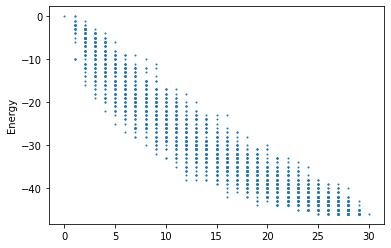

Best found: [0, 1, 2, 3, 4, 5, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29]
count: 25
Energy: -46.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 5, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29]
Supplier Energy 3.3458130000000073


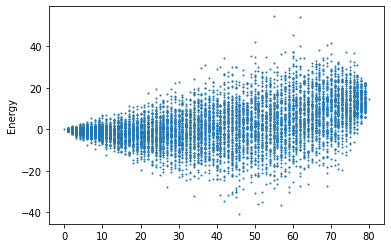

Best found: [0, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 15, 19, 26, 27, 33, 34, 36, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 49, 50, 51, 52, 55, 56, 57, 59, 61, 62, 63, 65, 66, 69, 71, 75, 79]
count: 46
Energy: -40.739999999999604
Solutions Sampled: 7862
Ideal items: [0, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 15, 19, 26, 27, 33, 34, 36, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 49, 50, 51, 52, 55, 56, 57, 59, 61, 62, 63, 65, 66, 69, 71, 75, 79]
Items energy: -40.739999999999604
max random 30


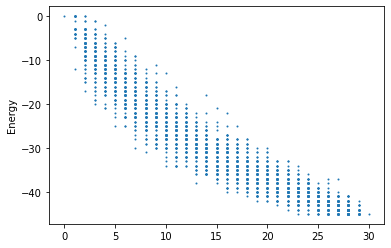

Best found: [0, 1, 2, 3, 4, 7, 8, 9, 10, 12, 14, 15, 16, 17, 18, 20, 21, 22, 24, 25, 27, 28, 29]
count: 23
Energy: -45.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 7, 8, 9, 10, 12, 14, 15, 16, 17, 18, 20, 21, 22, 24, 25, 27, 28, 29]
Supplier Energy 1.2207299999999983


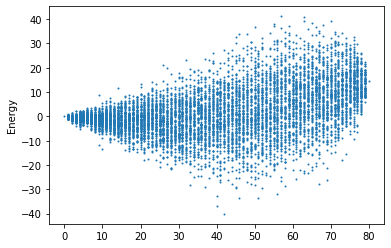

Best found: [2, 4, 7, 8, 9, 10, 13, 14, 15, 17, 21, 22, 23, 24, 25, 26, 27, 33, 34, 36, 38, 40, 42, 45, 46, 48, 49, 50, 55, 56, 57, 60, 62, 63, 69, 70, 71, 72, 73, 74, 76, 79]
count: 42
Energy: -40.11999999999991
Solutions Sampled: 7862
Ideal items: [2, 4, 7, 8, 9, 10, 13, 14, 15, 17, 21, 22, 23, 24, 25, 26, 27, 33, 34, 36, 38, 40, 42, 45, 46, 48, 49, 50, 55, 56, 57, 60, 62, 63, 69, 70, 71, 72, 73, 74, 76, 79]
Items energy: -40.11999999999991
max random 30


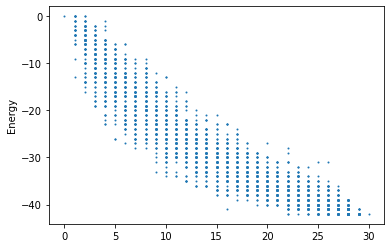

Best found: [0, 1, 2, 3, 4, 5, 6, 8, 9, 12, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 27]
count: 22
Energy: -42.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 3, 4, 5, 6, 8, 9, 12, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 27]
Supplier Energy 0.9457800000000008


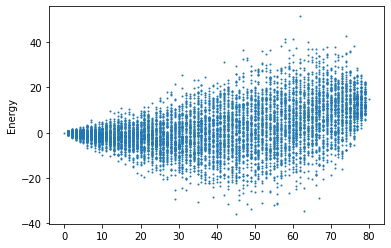

Best found: [1, 3, 5, 6, 7, 8, 9, 10, 12, 13, 14, 18, 24, 25, 26, 28, 31, 38, 39, 40, 46, 47, 50, 52, 53, 55, 56, 57, 58, 59, 60, 61, 62, 65, 66, 67, 68, 69, 71, 72, 73, 74, 75, 78, 79]
count: 45
Energy: -35.809999999999704
Solutions Sampled: 7862
Ideal items: [1, 3, 5, 6, 7, 8, 9, 10, 12, 13, 14, 18, 24, 25, 26, 28, 31, 38, 39, 40, 46, 47, 50, 52, 53, 55, 56, 57, 58, 59, 60, 61, 62, 65, 66, 67, 68, 69, 71, 72, 73, 74, 75, 78, 79]
Items energy: -35.809999999999704
max random 30


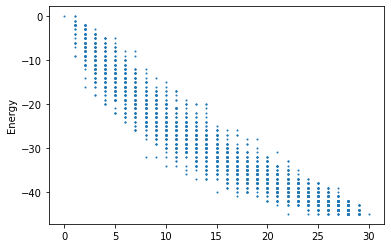

Best found: [0, 2, 3, 4, 5, 7, 8, 10, 11, 14, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28]
count: 22
Energy: -45.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 5, 7, 8, 10, 11, 14, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28]
Supplier Energy -1.4354470000000004


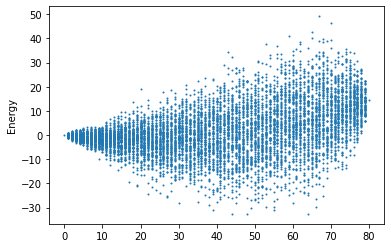

Best found: [2, 4, 5, 6, 7, 9, 11, 13, 14, 15, 16, 21, 22, 23, 25, 26, 28, 31, 33, 34, 36, 37, 38, 39, 44, 49, 50, 52, 53, 54, 56, 57, 58, 60, 62, 66, 68, 69, 70, 72, 73, 74, 75, 77]
count: 44
Energy: -32.58999999999981
Solutions Sampled: 7862
Ideal items: [2, 4, 5, 6, 7, 9, 11, 13, 14, 15, 16, 21, 22, 23, 25, 26, 28, 31, 33, 34, 36, 37, 38, 39, 44, 49, 50, 52, 53, 54, 56, 57, 58, 60, 62, 66, 68, 69, 70, 72, 73, 74, 75, 77]
Items energy: -32.58999999999981
max random 30


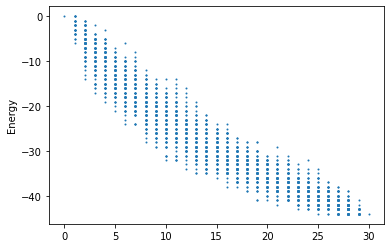

Best found: [0, 1, 2, 4, 5, 6, 7, 8, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28]
count: 25
Energy: -44.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 1, 2, 4, 5, 6, 7, 8, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28]
Supplier Energy 0.110293999999999


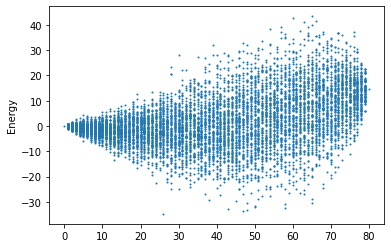

Best found: [3, 4, 9, 10, 11, 13, 14, 15, 16, 22, 26, 34, 36, 38, 39, 41, 49, 50, 55, 56, 58, 59, 65, 69, 71, 72]
count: 26
Energy: -34.75
Solutions Sampled: 7862
Ideal items: [3, 4, 9, 10, 11, 13, 14, 15, 16, 22, 26, 34, 36, 38, 39, 41, 49, 50, 55, 56, 58, 59, 65, 69, 71, 72]
Items energy: -34.75
max random 30


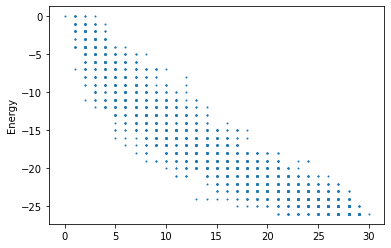

Best found: [0, 2, 3, 4, 6, 7, 8, 9, 11, 16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 28, 29]
count: 21
Energy: -26.0
Solutions Sampled: 2762
Min Suppliers to cover items: [0, 2, 3, 4, 6, 7, 8, 9, 11, 16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 28, 29]
Supplier Energy -1.0951469999999988


In [59]:
# Scenario B - Plotting
plot_sup2=[]
plot_prod2=[]
total=20
for trials in range(total):
    #ideal items from Mi
    p_items=ProbabilisticSampler(Mi,100)
    print('Ideal items:', p_items[0])
    print('Items energy:', p_items[1])
    plot_prod2.append(p_items[1])
    # now find suppliers that cover these items:
    # this is a set cover problem
    
    sup_list=SetCoverSampler(Ma,p_items[0],100)
    print('Min Suppliers to cover items:',sup_list[0])
    sup_energy=0
    for i in sup_list[0]:
        for j in sup_list[0]:
            if i<=j:
                sup_energy+=Ms[i,j]
    print('Supplier Energy',sup_energy)
    
    plot_sup2.append(sup_energy)

Text(0.5, 1.0, 'Find optimal supplier and product')

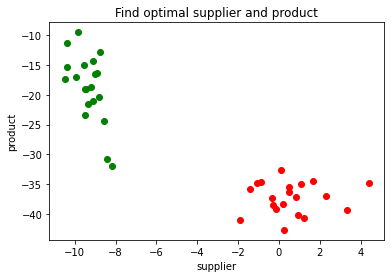

In [60]:
# now plot
plt.scatter(plot_sup1,plot_prod1,color='green')
plt.scatter(plot_sup2,plot_prod2,color='red')
            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')

#### Use D-Wave to find best energy values

In [61]:
# Scenario A
dwave_plot_sup1=[]
dwave_plot_prod1=[]

sup_result=run_dwave(Ms,0.5)

Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
26843545600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 ... 29     energy num_oc. ...
0     1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.68817      67 ...
1492  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.68817       1 ...
1     1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.58515      43 ...
1557  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.58515       1 ...
2     1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.56314      30 ...
2377  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.56314       1 ...
2467  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.56314       1 ...
3058  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.56314       1 ...
3353  1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  0  -11.56314       1 ...
3     1  0  0  0  0  1  1  1  1  1  1  1  0  0  1 ...  1  -11.54137      26 .

In [62]:
i=sup_result.first
print(i)
print(i.sample[0])

Sample(sample={0: 1, 1: 0, 2: 0, 3: 0, 4: 0, 5: 1, 6: 1, 7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 12: 0, 13: 0, 14: 1, 15: 0, 16: 0, 17: 0, 18: 0, 19: 0, 20: 1, 21: 1, 22: 0, 23: 0, 24: 0, 25: 0, 26: 0, 27: 0, 28: 1, 29: 0}, energy=-11.688170000000003, num_occurrences=67, chain_break_fraction=0.0)
1


In [63]:
first_sup=sup_result.first    
sup_list=[]
for s in range(len(Ms)):
    if first_sup.sample[s]==1:
        sup_list.append(s)
print(sup_list)
print('Supplier energy', first_sup[1])
dwave_plot_sup1.append(first_sup[1])    
a=availability(sup_list,Ma)
print('Items available:',len(a),a)   
m_i=item_m(a, Mi)
print(np.shape(m_i))
item_result=run_dwave(m_i,0.5)

[0, 5, 6, 7, 8, 9, 10, 11, 14, 20, 21, 28]
Supplier energy -11.688170000000003
Items available: 54 [ 0  1  2  3  5  8  9 13 15 16 17 18 20 22 23 24 25 27 29 30 31 32 33 34
 35 36 37 38 39 40 41 42 44 45 46 47 48 49 50 51 52 53 55 57 58 66 69 70
 74 75 76 77 78 79]
(54, 54)
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
450359962737049600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 ... 53 energy num_oc. ...
0     0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97      36 ...
2     0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97      31 ...
3     0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97      23 ...
4     0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97      33 ...
9     0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97      21 ...
10    0  1  1  1  1  1  1  1  1  0  0  0  0  0  1  0 ...  1 -38.97      31 ...
11    0  1  1  1  1  1  1  1  1  0  0  0  0

In [64]:
print(item_result.first)

Sample(sample={0: 0, 1: 1, 2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1, 9: 0, 10: 0, 11: 0, 12: 0, 13: 0, 14: 1, 15: 0, 16: 1, 17: 0, 18: 0, 19: 0, 20: 0, 21: 0, 22: 0, 23: 1, 24: 0, 25: 0, 26: 1, 27: 1, 28: 1, 29: 1, 30: 0, 31: 1, 32: 1, 33: 0, 34: 0, 35: 0, 36: 0, 37: 0, 38: 0, 39: 0, 40: 0, 41: 1, 42: 0, 43: 1, 44: 1, 45: 0, 46: 1, 47: 1, 48: 1, 49: 1, 50: 0, 51: 1, 52: 1, 53: 1}, energy=-38.969999999999885, num_occurrences=36, chain_break_fraction=0.018518518518518517)


In [65]:
first_item=item_result.first
itm_list=[]
for s in range(len(m_i)):
    if first_item.sample[s]==1:
        itm_list.append(s)
print('items:',itm_list)
i_item=np.zeros(len(itm_list))
for i in range(len(itm_list)):
    i_item[i]=a[itm_list[i]]
print('Items in solution:',i_item)
#print('count', len(p_items[0]))
print('Item Energy:', first_item[1])
dwave_plot_prod1.append(first_item[1])

items: [1, 2, 3, 4, 5, 6, 7, 8, 14, 16, 23, 26, 27, 28, 29, 31, 32, 41, 43, 44, 46, 47, 48, 49, 51, 52, 53]
Items in solution: [ 1.  2.  3.  5.  8.  9. 13. 15. 23. 25. 34. 37. 38. 39. 40. 42. 44. 53.
 57. 58. 69. 70. 74. 75. 77. 78. 79.]
Item Energy: -38.969999999999885


Text(0.5, 1.0, 'Find optimal supplier and product')

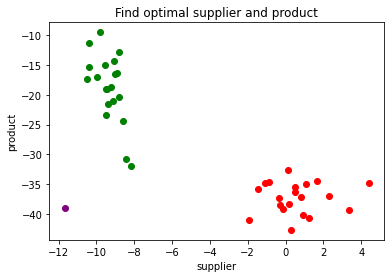

In [66]:
# now plot
plt.scatter(dwave_plot_sup1,dwave_plot_prod1,color='purple')
# now plot
plt.scatter(plot_sup1,plot_prod1,color='green')
plt.scatter(plot_sup2,plot_prod2,color='red')
            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')

In [67]:
#Scenario B

In [68]:
# plot various values
dwave_plot_sup2=[]
dwave_plot_prod2=[]

In [69]:
#ideal items from Mi
item_results=run_dwave(Mi,0.5)

Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
30223145490365729367654400
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 ... 79 energy num_oc. ...
13    0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       8 ...
37    0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       3 ...
55    0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       3 ...
56    0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       3 ...
96    0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       3 ...
104   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       1 ...
124   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       1 ...
125   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       1 ...
154   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39       2 ...
195   0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1 ...  1 -90.39      

In [70]:
first_item=item_results.first
itm_list=[]
for s in range(len(Mi)):
    if first_item.sample[s]==1:
        itm_list.append(s)
print('items:',itm_list)
print('Supplier energy', first_item[1])
dwave_plot_prod2.append(first_item[1])

items: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 19, 25, 26, 34, 37, 38, 39, 40, 41, 42, 43, 44, 46, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Supplier energy -90.38999999999956


max random 30


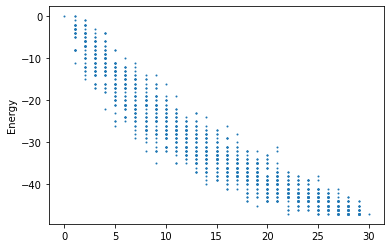

Best found: [0, 2, 3, 4, 5, 7, 8, 9, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 29]
count: 22
Energy: -47.0
Solutions Sampled: 1412


In [71]:
sup_list=SetCoverSampler(Ma,itm_list,50)

In [72]:
print('Min Suppliers to cover items:',sup_list[0])
sup_energy=0
for i in sup_list[0]:
    for j in sup_list[0]:
        if i<=j:
            sup_energy+=Ms[i,j]
print('Supplier Energy',sup_energy)

dwave_plot_sup2.append(sup_energy)

Min Suppliers to cover items: [0, 2, 3, 4, 5, 7, 8, 9, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 29]
Supplier Energy 0.16983399999999993


Text(0.5, 1.0, 'Find optimal supplier and product')

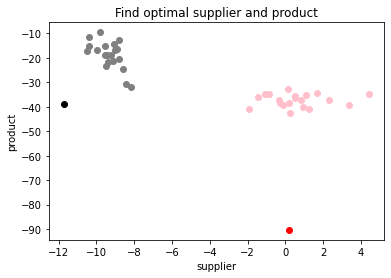

In [73]:
# now plot
plt.scatter(dwave_plot_sup1,dwave_plot_prod1,color='black')
plt.scatter(dwave_plot_sup2,dwave_plot_prod2,color='red')
# now plot
plt.scatter(plot_sup1,plot_prod1,color='gray')
plt.scatter(plot_sup2,plot_prod2,color='pink')
            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')

#### Create new combined matrix

In [75]:
A=0.5
S=2.5
I=0.5

Ma2=Ma.copy()
Ma2 = np.where(Ma2==1, -A, 0)
print(Ma2)
print(np.shape(Ma2))

[[ 0.   0.   0.  ...  0.   0.   0. ]
 [ 0.  -0.5  0.  ... -0.5  0.   0. ]
 [ 0.   0.   0.  ...  0.   0.   0. ]
 ...
 [-0.5  0.   0.  ...  0.   0.   0. ]
 [-0.5  0.  -0.5 ...  0.   0.   0. ]
 [ 0.   0.   0.  ...  0.   0.   0. ]]
(30, 80)


In [76]:
Mz=np.zeros([len(Mi),len(Ms)],dtype=float)
print('Mz',np.shape(Mz))
Msz=np.append(S*Ms, Mz, axis=0)
print('Msz',np.shape(Msz))

Mai=np.append(Ma2, I*Mi, axis=0)
print('Mai',np.shape(Mai))

Mf=np.append(Msz,Mai, axis=1)
print('Mf',np.shape(Mf))
print(Mf)
np.savetxt('Mf.csv', Mf, delimiter=',')

Mz (80, 30)
Msz (110, 30)
Mai (110, 80)
Mf (110, 110)
[[-3.25     0.08375  0.12275 ...  0.       0.       0.     ]
 [ 0.      -0.415    0.23575 ... -0.5      0.       0.     ]
 [ 0.       0.      -0.365   ...  0.       0.       0.     ]
 ...
 [ 0.       0.       0.      ... -0.195    0.35     0.01   ]
 [ 0.       0.       0.      ...  0.       0.1     -0.45   ]
 [ 0.       0.       0.      ...  0.       0.      -0.17   ]]


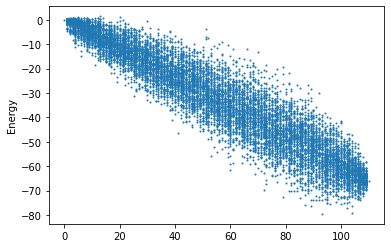

Best found: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 50, 51, 52, 53, 54, 55, 56, 57, 61, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 91, 92, 93, 95, 98, 99, 101, 102, 103, 104, 105, 106, 107, 109]
count: 93
Energy: -79.58464249999996
Solutions Sampled: 10902


In [77]:
result=ProbabilisticSampler(Mf,100)

In [78]:
sup_list=[]
item_list=[]
for i in (result[0]):
    if i<len(Ms):
        sup_list.append(i)
    else:
        item_list.append(i-len(Ms))

print(sup_list)

sup_energy=0
for i in sup_list:
    for j in sup_list:
        if i<=j:
            sup_energy+=Ms[i,j]
print('Supplier Energy',sup_energy)

print(item_list)

item_energy=0
for i in item_list:
    for j in item_list:
        if i<=j:
            item_energy+=Mi[i,j]
print('Item Energy',item_energy)

a=availability(sup_list,Ma)
print('all items available',a)

# Is this feasible:
if(np.isin(False,(np.isin(item_list,a)))):
    print('Not feasible')
    print(np.isin(item_list,a))
else:
    print('Feasible')
    

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29]
Supplier Energy 3.2101430000000053
[0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 21, 22, 23, 24, 25, 26, 27, 31, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 61, 62, 63, 65, 68, 69, 71, 72, 73, 74, 75, 76, 77, 79]
Item Energy -27.219999999999594
all items available [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 32 33 34 35 36 37 38 39 40 41 42 44 45 46 47 48 49
 50 51 52 53 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74
 75 76 77 78 79]
Not feasible
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True False  True  True  True  True  True  True  True  True  True  True
 False  True  True  True  True  True  True  True  True  True False  True
  True  True  Tru

In [79]:
A=0.5
S=2.5
I=0.5

Ma2=Ma.copy()
Ma2 = np.where(Ma2==1, -A, 0)
print(Ma2)
print(np.shape(Ma2))

Mz=np.zeros([len(Mi),len(Ms)],dtype=float)
print('Mz',np.shape(Mz))
Msz=np.append(S*Ms, Mz, axis=0)
print('Msz',np.shape(Msz))

Mai=np.append(Ma2, I*Mi, axis=0)
print('Mai',np.shape(Mai))

Mf=np.append(Msz,Mai, axis=1)
print('Mf',np.shape(Mf))
print(Mf)
np.savetxt('Mf.csv', Mf, delimiter=',')


result=run_dwave(Mf,0.5)


[[ 0.   0.   0.  ...  0.   0.   0. ]
 [ 0.  -0.5  0.  ... -0.5  0.   0. ]
 [ 0.   0.   0.  ...  0.   0.   0. ]
 ...
 [-0.5  0.   0.  ...  0.   0.   0. ]
 [-0.5  0.  -0.5 ...  0.   0.   0. ]
 [ 0.   0.   0.  ...  0.   0.   0. ]]
(30, 80)
Mz (80, 30)
Msz (110, 30)
Mai (110, 80)
Mf (110, 110)
[[-3.25     0.08375  0.12275 ...  0.       0.       0.     ]
 [ 0.      -0.415    0.23575 ... -0.5      0.       0.     ]
 [ 0.       0.      -0.365   ...  0.       0.       0.     ]
 ...
 [ 0.       0.       0.      ... -0.195    0.35     0.01   ]
 [ 0.       0.       0.      ...  0.       0.1     -0.45   ]
 [ 0.       0.       0.      ...  0.       0.      -0.17   ]]
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
1481  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1 -114.102975       1 ...
3877  1  1  1  0  0  1  1  1  1 

In [80]:
dwave_plot_sup3=[]
dwave_plot_prod3=[]
dwave_plot_sup4=[]
dwave_plot_prod4=[]

for datum in (result.data()):
    sup_list=[]
    item_list=[]
    for s in range(len(Ms)):
        if datum.sample[s]==1:
            sup_list.append(s)
    
    
    for i in range(len(Ms),len(Ms)+len(Mi)):
        if datum.sample[i]==1:
            item_list.append(i-len(Ms))

    #print(sup_list)

    sup_energy=0
    for i in sup_list:
        for j in sup_list:
            if i<=j:
                sup_energy+=Ms[i,j]
    #print('Supplier Energy',sup_energy)

    #print(item_list)

    item_energy=0
    for i in item_list:
        for j in item_list:
            if i<=j:
                item_energy+=Mi[i,j]
    #print('Item Energy',item_energy)

    a=availability(sup_list,Ma)
    #print('all items available',a)

    # Is this feasible:
    if(np.isin(False,(np.isin(item_list,a)))):
        #print('Not feasible')
        #print(np.isin(item_list,a))
        dwave_plot_sup3.append(sup_energy)
        dwave_plot_prod3.append(item_energy)
    else:
        print('Feasible')
        print('suppliers:',sup_energy, sup_list)
        print('products:', item_energy, item_list)
        dwave_plot_sup4.append(sup_energy)
        dwave_plot_prod4.append(item_energy)


Feasible
suppliers: -6.977529999999998 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 26, 27, 28]
products: -69.06999999999947 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 74, 76, 77, 78, 79]


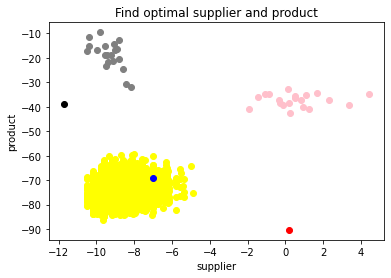

In [81]:
# now plot
plt.scatter(dwave_plot_sup1,dwave_plot_prod1,color='black')
plt.scatter(dwave_plot_sup2,dwave_plot_prod2,color='red')

# now plot
plt.scatter(plot_sup1,plot_prod1,color='gray')
plt.scatter(plot_sup2,plot_prod2,color='pink')

plt.scatter(dwave_plot_sup3,dwave_plot_prod3,color='yellow')
plt.scatter(dwave_plot_sup4,dwave_plot_prod4,color='blue')

            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')
plt.show()

In [83]:
dwave_plot_sup3=[]
dwave_plot_prod3=[]
dwave_plot_sup4=[]
dwave_plot_prod4=[]

save_sup_list=[]
save_sup_energy=[]
save_item_list=[]
save_item_energy=[]


for A in np.arange(0.5, 1.0, 0.2):
    for S in np.arange (2.0, 3.5, 0.5):
        for I in np.arange (0.5, 1.0, 0.2):
            print('Starting:',A,S,I)
            Ma2=Ma.copy()
            Ma2 = np.where(Ma2==1, -A, 0)
            Mz=np.zeros([len(Mi),len(Ms)],dtype=float)
            Msz=np.append(S*Ms, Mz, axis=0)
            Mai=np.append(Ma2, I*Mi, axis=0)
            Mf=np.append(Msz,Mai, axis=1)

            result=run_dwave(Mf,0.5)

            for datum in (result.data()):
                sup_list=[]
                item_list=[]
                for s in range(len(Ms)):
                    if datum.sample[s]==1:
                        sup_list.append(s)


                for i in range(len(Ms),len(Ms)+len(Mi)):
                    if datum.sample[i]==1:
                        item_list.append(i-len(Ms))


                sup_energy=0
                for i in sup_list:
                    for j in sup_list:
                        if i<=j:
                            sup_energy+=Ms[i,j]


                item_energy=0
                for i in item_list:
                    for j in item_list:
                        if i<=j:
                            item_energy+=Mi[i,j]


                a=availability(sup_list,Ma)


                # Is this feasible:
                if(np.isin(False,(np.isin(item_list,a)))):

                    dwave_plot_sup3.append(sup_energy)
                    dwave_plot_prod3.append(item_energy)
                else:
                    print('Feasible')
                    print('suppliers:',sup_energy, sup_list)
                    print('products:', item_energy, item_list)
                    save_sup_energy.append(sup_energy)
                    save_sup_list.append(sup_list)
                    save_item_energy.append(item_energy)
                    save_item_list.append(item_list)
                    
                    dwave_plot_sup4.append(sup_energy)
                    dwave_plot_prod4.append(item_energy)


Starting: 0.5 2.0 0.5
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
66    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -110.59666       1 ...
1603  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -110.52666       1 ...
0     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -110.45166       1 ...
100   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -110.44166       1 ...
24    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -110.3835       1 ...
152   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -110.38166       1 ...
353   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -110.3585       1 ...
534   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -110.33166       1 ...
8     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -110.30538       1 ...
556   1  1  1  0  0  1  1  1  1  1  1  1 

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -77.10999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.48999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.87999999999948 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.11999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -6.56843 [0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -79.70999999999948 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -78.83999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
sup

Feasible
suppliers: -6.56843 [0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -82.69999999999948 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -83.95999999999947 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -6.1589599999999995 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -81.0699999999995 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -7.28062

Starting: 0.5 2.5 0.7
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
571   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.314675       1 ...
74    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.181675       1 ...
223   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.181675       1 ...
408   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.181675       1 ...
1309  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.181675       1 ...
1690  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.181675       1 ...
43    1  1  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -130.15775       1 ...
11    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.115675       1 ...
155   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -130.115675       1 ...
229   1  0  0  0  0  1  1  1  1  1  1  1 

Starting: 0.5 2.5 0.8999999999999999
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
15    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
186   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
254   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
337   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
392   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
694   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
978   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
1189  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
1205  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1 -147.374675       1 ...
2992  1  0  0  0  0  1  1 

Starting: 0.5 3.0 0.5
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
31    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.64421       1 ...
3     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.49421       1 ...
7     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.43421       1 ...
387   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.41059       1 ...
0     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.40511       1 ...
73    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.38921       1 ...
6     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.37921       1 ...
156   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.37921       1 ...
9     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -118.37421       1 ...
71    1  0  0  0  0  1  1  1  1  1  1  1 

Starting: 0.5 3.0 0.7
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
14    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.11621       1 ...
576   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -135.02221       1 ...
41    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -134.98321       1 ...
71    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -134.98321       1 ...
173   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -134.98321       1 ...
2529  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -134.98321       1 ...
2907  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -134.98321       1 ...
188   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -134.91721       1 ...
339   1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -134.85821       1 ...
731   1  0  0  0  0  1  1  1  1  1  1  1 

Starting: 0.5 3.0 0.8999999999999999
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
4622  1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -152.10921       1 ...
2     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.94021       2 ...
3     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.94021       1 ...
4     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.94021       2 ...
5     1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.94021       2 ...
12    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.94021       1 ...
19    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.94021       1 ...
28    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.94021       1 ...
43    1  0  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.94021       1 ...
47    1  0  0  0  0  1  1 

Starting: 0.7 2.0 0.5
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
10    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.3659       1 ...
278   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.3659       1 ...
1210  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.3659       1 ...
30    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.2659       1 ...
68    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.2659       1 ...
118   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.2659       1 ...
310   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.2659       1 ...
488   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.2659       1 ...
16    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -138.1809       1 ...
0     1  1  1  0  0  1  1  1  1  1  1  1 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.91999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.91999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.58999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.34999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.53999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.509999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.41999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.40999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.39999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.739999999999284 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.93999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.32999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 34, 36,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.70999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.899999999999174 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.89999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.33999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.71999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.719999999999175 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.38999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.16999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.1599999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.90999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.099999999999284 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.29999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.42999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.01999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.60999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.14999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.749999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.34999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.96999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.35999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.35999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.72999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.9299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.72999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.399999999999274 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -59.37999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.77999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45

Feasible
suppliers: -3.2405899999999996 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -59.12999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.509999999999174 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.9099999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.13999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.52999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.75999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.34999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.31999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -61.48999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.659999999999165 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -62.91999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.04999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 5

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -59.679999999999204 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -63.86999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.469999999999274 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 4

products: -57.679999999999296 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.87999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 42, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.67999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppli

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -62.05999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.059999999999334 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -62.31999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 5

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.849999999999326 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 25, 26, 27, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.83999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.0299999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51,

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -61.83999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 55, 56, 57, 58, 60, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.36999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.159999999999144 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 42, 45, 46, 47, 4

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -55.92999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.48999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.23999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -68.07999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -55.46999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.68999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47

Feasible
suppliers: -3.650159999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -59.21999999999915 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.42999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -59.689999999999294 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 42,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.79999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.37999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.96999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.31999999999913 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.0699999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.65999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.569999999999226 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 67, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.2405899999999996 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -61.35999999999915 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -64.1399999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -52.58999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.979999999999336 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.56999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 4

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -59.569999999999204 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -60.95999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.089999999999336 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 4

Feasible
suppliers: -4.07459 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -55.48999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -55.989999999999206 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.74999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 4

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -53.00999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 49, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -61.13999999999922 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.2405899999999996 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -54.12999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.80999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 55, 56, 57, 58, 60, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.067440999999999 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -68.0699999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.7599999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49,

Feasible
suppliers: -4.240449999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 25, 26, 27, 28, 29]
products: -50.819999999999354 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 74, 75, 76, 77, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.07999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 55, 56, 57, 58, 59, 60, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -4.07459 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -62.41999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 4

Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
2     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.18316       1 ...
71    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.18316       1 ...
96    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.18316       1 ...
147   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.18316       1 ...
549   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.18316       1 ...
698   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.18316       1 ...
937   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.18316       1 ...
978   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.18316       1 ...
2902  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.18316       1 ...
3054  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -151.18

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.71999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.71999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.41999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.03999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.03999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.4599999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.70999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.40999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.66999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.41999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.40999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.28999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 5

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.65999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.649999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.20999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41,

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.78999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.50999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.33999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41,

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.80999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.60999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.14999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38, 39, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.68999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.39999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.67999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.2999999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.47999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.47999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.41999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.41999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.30999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 55, 56, 57, 58, 59, 6

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.02999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.449259999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -78.14999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.19999999999946 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 46, 47, 48, 50, 52, 53

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.8899999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.16999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.1699999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63

Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -80.81999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.04999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.93999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.86999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.85999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.067440999999999 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -76.74999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 6

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.61999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.61999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.449259999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -79.45999999999951 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 66, 69, 7

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.27999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.8099999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.80999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 

Feasible
suppliers: -4.067440999999999 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -81.10999999999946 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.5999999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.91999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.85999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.650159999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.95999999999927 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.116941000000001 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -78.47999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 

Feasible
suppliers: -3.650159999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -77.59999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.115679999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -75.25999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.45999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60,

Feasible
suppliers: -4.067440999999999 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -73.97999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.74999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.31999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 27, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56,

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.2499999999995 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 50, 52, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -76.00999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.9785799999999982 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -69.6999999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -77.97999999999955 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.449259999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -74.31999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.548659999999998 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -71.0299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 6

Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
9     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -166.77216       1 ...
172   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -166.77216       1 ...
594   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -166.77216       1 ...
821   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -166.77216       1 ...
120   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -166.5815       1 ...
800   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -166.5815       1 ...
1138  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -166.5815       1 ...
2541  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -166.5815       1 ...
3     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -166.54516       1 ...
4     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -166.54

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.83999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.83999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -80.81999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.28999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.17999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.19999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 5

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -79.82999999999949 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.067440999999999 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -77.99999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.449259999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -81.03999999999947 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -78.66999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -81.46999999999954 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -79.17999999999944 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.29999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -78.9199999999995 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.13999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -78.15999999999946 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -75.13999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -71.73999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -75.97999999999946 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -5.50992 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 29]
products: -81.43999999999946 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -74.75999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 52, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible


Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.129999999999164 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.43999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.62999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.3699999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.19999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.909999999999194 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.20999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.17999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.14999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -58.069999999999204 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.509999999999266 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -58.3999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 4

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.33999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.529999999999234 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -64.50999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39,

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -57.01999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.71999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -69.58999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.06999999999928 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.91999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -58.75999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.18999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -65.3099999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.41999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 

Feasible
suppliers: -6.1589599999999995 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -61.08999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -62.33999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -59.5099999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.26999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.3599999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -60.0499999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 5

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.979999999999286 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -65.07999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.84999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 5

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.549999999999294 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.449259999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -60.119999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -69.22999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 47, 48, 50,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.6299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -72.71999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -71.55999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.71999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.42216 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -72.65999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -71.26999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 7

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.10999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -79.33999999999956 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Starting: 0.7 3.0 0.5
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
0     1  1  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -142.73668       1 ...
18    1  

Starting: 0.7 3.0 0.7
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
119   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -156.09499       1 ...
0     1  1  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -155.97368       1 ...
8410  1  1  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -155.93868       1 ...
163   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -155.93257       1 ...
2704  1  1  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -155.84768       1 ...
114   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -155.83599       1 ...
2     1  1  0  0  0  1  1  1  1  1  1  1  0  0 ...   1  -155.81792       1 ...
37    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -155.80657       1 ...
375   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -155.80657       1 ...
4569  1  1  1  0  0  1  1  1  1  1  1  1 

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -75.79999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -72.61999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -6.56843 [0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -71.9599999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 7

Starting: 0.8999999999999999 2.0 0.5
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
0     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
4     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       4 ...
5     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       2 ...
16    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       2 ...
27    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
43    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
72    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
82    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
92    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -169.10582       1 ...
93    1  1  1  0  0  1  1 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -44.7499999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -44.7499999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -44.7499999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.91999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.91999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.91999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.18999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.18999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.18999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.66999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.66999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.66999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.19999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.19999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.19999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.96999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.96999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.96999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 2

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.759999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.759999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.759999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.99999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.99999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.57999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.60999999999905 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.19999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.19999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.49999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.49999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.49999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.42999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.22999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.22999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.21999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.21999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.21999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.9399999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.9399999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.9399999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -46.22999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -46.22999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.629999999999114 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.959999999999184 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.80999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.60999999999902 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.679999999999076 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.679999999999076 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.679999999999076 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.00999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.269999999999015 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.269999999999015 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.219999999999146 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.01999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.01999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.18999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.18999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.18999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.97999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.97999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.66999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.51999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.51999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.51999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -43.55999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.95999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.759999999999195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -45.56999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.7699999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.04999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.39999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.39999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.7999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17

Feasible
suppliers: -1.572979999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.59999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.519999999999115 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.68999999999904 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.43999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.43999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.23999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.88999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.1799999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.1799999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.80999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.529999999999056 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.49999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16,

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.00999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.059999999999114 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.059999999999114 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.96999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.96999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.67999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.94999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.51999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.51999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.839999999999144 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.22999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.7299999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 2

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.009999999999074 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.009999999999074 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.97999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.3099999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -45.50999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.92999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.629999999999114 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.629999999999114 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.629999999999114 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.54999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.54999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.53999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.76999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.44999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.45999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14,

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.96999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.04999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.572979999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.26999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.699999999999214 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.919999999999035 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.289999999999054 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.82999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.82999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.82999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 2

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.97999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.57999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.34999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.46999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.46999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.03999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -45.899999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.97999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.97999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.66999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -47.74999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.19999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,

Feasible
suppliers: -1.572979999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.29999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.41999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.06999999999904 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.92999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.12999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.12999999999903 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.43999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.4099999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.93999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.95999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.95999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.95999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 2

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.37999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.25999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.86999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16,

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.379999999999086 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.18999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.409999999999116 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.81999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.509999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.50999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 

Feasible
suppliers: -2.5028799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.76999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.63999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.799999999999045 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 1

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.63999999999904 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.75999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.12999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.67999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.679999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.190779999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.44999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.58999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.5599999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.5599999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.269999999999136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.059999999999114 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.90999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.76999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.3699999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.7399999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.47999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.49999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.669999999999185 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.55999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.55999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.55999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.2999999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.29999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.29999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.38999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.55999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.529999999999085 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.05999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.84999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.4499999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.17999999999909 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.3399999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 62, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.94999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20

Feasible
suppliers: -3.2405899999999996 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29]
products: -52.4299999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.12999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -43.84999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 2

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.29999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.089999999999016 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.2999999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 2

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.38999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.97999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.579999999999146 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.17999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.489999999999085 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.439999999998996 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.129999999999335 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.499999999999076 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.499999999999076 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.55999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.74999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.54999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 2

Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -45.639999999999354 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.72999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.80999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.269999999999314 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 64, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -46.45999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.67999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.089999999999144 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.669999999999106 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.059999999999086 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.10999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.299999999999166 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.90999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.27999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.4099999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.49999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.109999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 64, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.49999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.51999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.39999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.39999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.289999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.719999999999025 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.849999999999156 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.039999999999225 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24,

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.79999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -44.8899999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 64, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.199999999999164 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.9099999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.13999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.47999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.06999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.069999999999204 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.60999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24

Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.0299999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 64, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.83999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.25999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.77999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.319999999999126 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.10999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22,

Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.849999999999056 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.20999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.09999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18

Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.22999999999903 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 61, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.48999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.169999999999135 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.3799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.3799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.3799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.11999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.11999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.11999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 2

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.499999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.44999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.20999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 2

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.96999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.96999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.96999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.32999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.32999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.89999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.64999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.78999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.42999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.51999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.879999999999214 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.879999999999214 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.96999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.68999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.96999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.10999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.10999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.10999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 2

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.19999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.19999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.19999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.83999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.83999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.40999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.689999999999166 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.599999999999135 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.45999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 2

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.84999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.84999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.39999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.75999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.61999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -54.83999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.279999999999134 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.279999999999134 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.279999999999134 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.899999999999075 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.3199999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.03999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.15999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.15999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.15999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.0799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.62999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.43999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.3199999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.3199999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.3199999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 4

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.399999999999196 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.399999999999196 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.399999999999196 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.05999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.05999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.05999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.04999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.39999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.329999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.89999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.46999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.70999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25,

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.32999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.14999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.71999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.939999999999195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.509999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -67.66999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.18999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.52999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.5299999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 2

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.25999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.25999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.25999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -66.79999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.36999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.13999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40,

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.84999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.18999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.18999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.529999999999205 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.36999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.23999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.33999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.75999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.75999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42,

Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.42999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.2799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.99999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.749999999999226 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.37999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.37999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.359999999999225 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.359999999999225 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.359999999999225 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.14999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.369999999999195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: 0.8029090000000033 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.989999999999014 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.829999999999195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.82999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.67999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 37,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.62999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.62999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.189999999999095 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32

Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.55999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.07999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.1299999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.989999999999185 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.989999999999185 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.829999999999224 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 3

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.31999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.039999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.60999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 24, 25, 26, 32, 34, 37, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.41999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.25999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.499999999999204 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.30999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.109999999999175 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.93999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.90999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.90999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.90999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -65.99999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.83999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.1199999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.64999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.669999999999206 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.07999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 

Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.73999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.329999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.329999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38

Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.8399999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.24999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.189999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.8499999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.47999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.64999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.64999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.64999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.97999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.819999999999155 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -64.38999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.1599999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37,

Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.65999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.32999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.0499999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.1499999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.1499999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -70.00999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 25, 26, 32, 34, 37, 38, 39, 

Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.829999999999075 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.09999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.5199999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.44999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.44999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.43999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 5

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.579999999999124 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.109999999999225 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.39999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.47999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.33999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.33999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.29999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.29999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -65.29999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.4999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.21999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -64.6599999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.179999999999175 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -65.17999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.72999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.22999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -66.9699999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.09999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 32,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.1899999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.03999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.89999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.67999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.67999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.39999999999916 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47

Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.04999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.32999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.89999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 32

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.97999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.51999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.25999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41

products: -60.90999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -66.0499999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.44999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
su

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.64999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.079999999999146 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.21999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.009999999999295 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.74999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.48999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.06999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.67999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.21999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.84999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -0.1925909999999972 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.419999999999135 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.169999999999135 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.89999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.16999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.47999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37

Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.25999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.66999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.67999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.37999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.17999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.5799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.36999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.60999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 62, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -56.349999999999206 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 20, 22, 24, 25, 26, 32, 34, 36,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -69.08999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.919999999999355 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.91999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 5

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.39999999999925 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.38999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.389999999999304 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 37, 

Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.44999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.28999999999914 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -0.638109999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -66.9899999999992 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 24, 25, 26

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.699999999999186 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.10999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.3793909999999984 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.44999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.91999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.58999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.1288099999999983 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.159999999999215 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.70999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -60.709999999999226 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -62.53999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42

products: -59.199999999999214 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.93999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.92999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Fea

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -65.43999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.97999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.11999999999924 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.64999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.8799999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.5028799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.56999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -61.069999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 22, 23, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -72.63999999999932 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.58999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.67999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.22999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.239999999999284 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 25, 26, 32, 33, 34, 36, 37, 3

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.819999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 60, 61, 63, 65, 66, 69, 70, 71, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.949999999999044 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 62, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.339999999999364 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 23, 25, 26, 27, 32, 34

Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
24    1  1  1  1  0  1  1  1  1  1  1  1  0  0 ...   1 -192.411522       1 ...
98    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -192.39696       1 ...
0     1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -192.30942       1 ...
151   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -192.30942       1 ...
209   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -192.30942       1 ...
162   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -192.25296       1 ...
172   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1  -192.19896       1 ...
122   1  1  1  1  0  1  1  1  1  1  1  1  0  0 ...   1 -192.177522       1 ...
1     1  1  1  1  0  1  1  1  1  1  1  1  0  0 ...   1 -192.167522       1 ...
445   1  1  1  1  0  1  1  1  1  1  1  1  0  0 ...   1 -192.167

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.41999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.41999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.41999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44,

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.68999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.68999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.68999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.55999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.91999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.90999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.32999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.32999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.32999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.56999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.55999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.56999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44,

Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.42999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.14999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.38999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.3099999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.31999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.93999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39,

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.14999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.15999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.15999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44,

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.95999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.61999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.6099999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.53999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.40999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.77999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52,

Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -73.42999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.3420910000000001 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -74.42999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.29999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 

Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.57999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.63999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.18999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 3

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.42999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.16999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.42999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.94999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.94999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.27999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.87999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -71.8999999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.09999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 52, 53, 55, 56

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.60999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.60999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.97999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44,

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.81999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.81999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.8899999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 34, 37, 38, 39, 

Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.68999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.29999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.65999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 4

Feasible
suppliers: -0.7474609999999962 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.41999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.96999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -69.51999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 37, 38, 39, 40, 41, 4

Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.70999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.81999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.70999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 27, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 5

Feasible
suppliers: -0.1925909999999972 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -73.96999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.62999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.6752610000000008 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.6699999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.98999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 27, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.9499999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.67999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 4

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.89999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -0.1925909999999972 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -70.14999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.3699999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.74999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.74999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -46.74999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 1

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.349999999999184 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.349999999999184 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.0299999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -46.74999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -46.74999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -46.74999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.82999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.82999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.82999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.289999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.21999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.21999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.55999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.699999999999136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.689999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.43999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.43999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.43999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.519999999999115 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.63999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -49.419999999999185 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.559999999999135 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.559999999999135 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.559999999999135 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.92999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.92999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.129999999999164 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.61999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.61999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.52999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.01999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.33999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.99999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.60999999999905 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.19999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.45999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.09999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.22999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.22999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -51.139999999999176 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.7399999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.33999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.23999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.69999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.829999999999146 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.07999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.73999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.06999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.119999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.90999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.90999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 4

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.18999999999911 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -38.71999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.11999999999911 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.17999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.9699999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.8099999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 3

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.839999999999144 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.16999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.16999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.09999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.47999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -45.80999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.42999999999904 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.01999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.409999999999116 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 33, 34, 3

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -50.46999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -52.339999999999044 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.469999999999175 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.15999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -55.679999999999154 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.05999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.09999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.229999999999144 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.62999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 27, 32, 33

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.009999999999124 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.4099999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.97999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.17999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -44.50999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.30999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.93999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.739999999999156 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.52999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.94999999999906 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.349999999999234 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -53.52999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 24, 25, 26, 32, 34, 36, 37

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.50999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -48.69999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.6999999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.96999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.55999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.35999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.58999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.04999999999904 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.572979999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.69999999999907 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22, 23

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.909999999999144 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.84999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.21999999999909 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34,

Feasible
suppliers: -2.8756799999999996 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 25, 26, 27, 28, 29]
products: -45.65999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.26999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.599999999999234 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 23, 24, 25, 26,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -51.33999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.84999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.33999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40

Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
79    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -180.7862       1 ...
97    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -180.7862       1 ...
125   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -180.7862       1 ...
369   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -180.7862       1 ...
453   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -180.7862       1 ...
509   1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -180.7862       1 ...
1569  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -180.7862       1 ...
12    1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -180.7802       1 ...
2852  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -180.7802       1 ...
7091  1  1  1  0  0  1  1  1  1  1  1  1  0  0 ...   1   -180.7

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.579999999999174 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.579999999999174 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.3799999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.82999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.969999999999196 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.969999999999196 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.22999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.01999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.01999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.9699999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.23999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.23999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.59999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.73999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.879999999999214 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.229999999999166 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.9699999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.939999999999195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.51999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.51999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.51999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.9099999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.9099999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.9099999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 

Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.51999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.51999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.51999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.27999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.27999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.27999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 3

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.06999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.06999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.06999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 3

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.36999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.36999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.93999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 2

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.4499999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.299999999999244 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.819999999999176 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.61999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.46999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.60999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 3

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.75999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.36999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.219999999999246 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.02999999999926 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.59999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.26999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -59.459999999999184 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.45999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.02999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.07999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.64999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.789999999999246 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 5

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.81999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.81999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.81999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.65999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.03999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -63.03999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 2

Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.219999999999075 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.27999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.849999999999234 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 22, 23, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.56999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.03999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.319999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.07999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.21999999999915 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.78999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 3

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.40999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.499999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.499999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 4

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.98999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.7447609999999996 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.15999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 61, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.65999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.14999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.85999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.99999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.47999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -58.5199999999992 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.659999999999165 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37,

suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.23999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.80999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.80999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.27999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.98999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -64.69999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40,

Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -65.15999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.650159999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -64.27999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.8497610000000004 [0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.84999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.52999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.52999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.769999999999214 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.78999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 27, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.67999999999921 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.24999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.6399999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.679999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.48999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44,

Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.8899999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -58.88999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.4499999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 36

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.52999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.66999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.5907099999999987 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -64.41999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.97999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.299999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -57.67999999999914 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41

Feasible
suppliers: -3.030079999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.84999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.5505399999999985 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 29]
products: -53.96999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.68521 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -65.05999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37,

Feasible
suppliers: -3.116941000000001 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -65.72999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.02999999999913 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 59, 62, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -1.7654099999999984 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
products: -69.23999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 36

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.88999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.76999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.56999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.24999999999916 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 51, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -57.65999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 68, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.68999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.71999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.71999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.01999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.73999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.73999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.73999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.14999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.50999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.50999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.98999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.98999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.98999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.85999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.85999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.84999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.0899999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.07999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.70999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.98999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.98999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.61999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.51999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.51999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.51999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.42999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.42999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.42999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.39999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.39999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.3699999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.31999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.31999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.31999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.5799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.5799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.20999999999941 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 5

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.49999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.4899999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.11999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.05999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.04999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.40999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.98999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.98999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.98999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.9099999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.9099999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.9099999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 7

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.21999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.84999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.20999999999935 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52,

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.14999999999931 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.14999999999931 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.77999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.70999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.06999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.06999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.66999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.66999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -78.66999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.59999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.95999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.94999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.51999999999947 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.51999999999947 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.51999999999947 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.45999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -75.45999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.44999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.37999999999947 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.37999999999947 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -77.37999999999947 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.28999999999931 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.28999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.28999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 6

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.55999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.55999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.55999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.10999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.09999999999928 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.09999999999928 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.00999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.00999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.00999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65

products: -73.29999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.29999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.2899999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.84999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.19999999999928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.19999999999942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.70999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.70999999999941 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.6999999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.57999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.57999999999936 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -70.5699999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 7

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.8499999999993 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.84999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.46999999999937 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.3599999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.34999999999933 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.34999999999934 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 6

Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -69.58999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.145179999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -68.3399999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.5028799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.33999999999939 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.81999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -2.5028799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 16, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -76.0499999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 24, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.73999999999938 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.49999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.45999999999944 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -73.45999999999943 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -74.3499999999994 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.92999999999928 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.89999999999938 [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 6

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.19999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.759999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.759999999999145 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 2

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.02999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.0299999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.02999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.25999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.629999999999164 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.629999999999164 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.859999999999125 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.22999999999908 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -48.359999999999225 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 34, 35, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -53.2999999999991 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.07999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.58999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 27, 32, 34, 36, 37, 38,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -49.02999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.37999999999911 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -47.139999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 33, 34, 35, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -50.1599999999992 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.12999999999917 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.28999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41,

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -57.939999999999195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.32999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.889999999999176 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -54.00999999999919 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.599999999999206 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 25, 26, 32, 34, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -50.78999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 4

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -57.44999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -55.22999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -42.6199999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42,

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -53.37999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.51999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -52.10999999999912 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 34, 36, 37, 38, 39, 40, 41

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -59.93999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.989999999999256 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.93828 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -54.39999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 45, 46, 4

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.02999999999924 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 27, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -60.85999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Starting: 0.8999999999999999 3.0 0.7
Number of qubits:  5760
Number of couplers 40279
Shots max 10,000
32451855365842672678315602057625600
Recommended shots 10000
Estimated cost $2.20
      0  1  2  3  4  5  6  7  8  9 10 11 12 13 ... 109      energy num_oc. ...
410   1  1  1  0  0  

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.09999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.2799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -63.86999999999923 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.579999999999245 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -64.27999999999926 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -62.989999999999256 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.85999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.31999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -60.929999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -60.14999999999913 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -62.62999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -71.55999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 

products: -57.309999999999235 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.00999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.07999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
sup

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -63.28999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -65.82999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -66.36999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -65.99999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -67.26999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -64.68999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 4

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -67.96999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -55.759999999999216 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 60, 63, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -61.669999999999355 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 5

Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -56.10999999999921 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 24, 25, 26, 27, 32, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.115679999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -57.26999999999918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -68.09999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 36, 37, 38, 3

Feasible
suppliers: -6.1589599999999995 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -61.139999999999254 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.548659999999998 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -69.31999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 59, 62, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.1199999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44,

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -68.32999999999932 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.1924799999999993 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -66.52999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.42216 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -60.82999999999925 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53

Feasible
suppliers: -5.42216 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -65.45999999999927 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -68.3599999999995 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -57.169999999999234 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 23, 24, 25, 26, 32, 33, 34, 35, 36, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 6

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -65.53999999999932 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -59.10999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 25, 26, 32, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 60, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79]
Feasible
suppliers: -5.42216 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28]
products: -68.3399999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 53, 55, 56, 57

Feasible
suppliers: -4.115679999999999 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28]
products: -67.52999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 26, 34, 37, 38, 39, 40, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.50374 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 25, 26, 27, 29]
products: -63.58999999999935 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -3.650159999999999 [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -64.22999999999922 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 47, 48, 50, 51, 53, 55, 56

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -69.97999999999934 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.72999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.72999999999936 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -66.2799999999993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -74.69999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -74.69999999999935 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69,

Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.4499999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.4499999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -4.04458 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 25, 26, 27, 28, 29]
products: -72.4499999999994 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 7

Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -73.39999999999938 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 45, 46, 47, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -70.38999999999929 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -75.38999999999945 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 24, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72

Feasible
suppliers: -4.57846 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -67.38999999999932 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 22, 23, 24, 25, 26, 27, 32, 34, 37, 38, 39, 40, 41, 42, 44, 45, 46, 50, 51, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -67.74999999999933 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 22, 23, 24, 25, 26, 27, 32, 34, 35, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 65, 66, 69, 70, 71, 72, 73, 74, 76, 77, 78, 79]
Feasible
suppliers: -5.34476 [0, 1, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
products: -67.12999999999931 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 24, 25, 26, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 48, 49, 50, 52, 53, 55, 56, 57

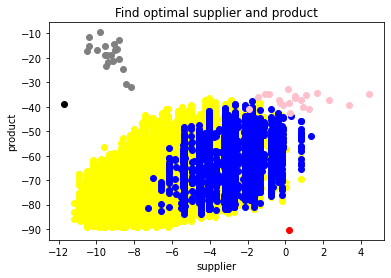

In [84]:
plt.scatter(dwave_plot_sup3,dwave_plot_prod3,color='yellow')
plt.scatter(dwave_plot_sup4,dwave_plot_prod4,color='blue')
# now plot
plt.scatter(plot_sup1,plot_prod1,color='gray')
plt.scatter(plot_sup2,plot_prod2,color='pink')


# now plot
plt.scatter(dwave_plot_sup1,dwave_plot_prod1,color='black')
plt.scatter(dwave_plot_sup2,dwave_plot_prod2,color='red')

            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')
plt.show()

In [130]:
S=10
I=1
global_score=[]
for i in range(len(save_sup_energy)):
    global_score.append(S*save_sup_energy[i]*I*save_item_energy[i])
    
index=np.argsort(ratio)
print(index,global_score[index[-1]])
print('supplier',save_sup_energy[index[-1]])
print(save_sup_list[index[-1]])
print('product',save_item_energy[index[-1]])
print(save_item_list[index[-1]])

[5354 8938 9258 ...   10   14   17] 5921.336378999961
supplier -7.280629999999997
[0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
product -81.3299999999995
[0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]


In [131]:
ef_sup_energy=[]
ef_item_energy=[]
N=20
n=0
for i in reversed(index):
    if n<N:
        print(global_score[i])
        print(' supplier',save_sup_energy[i])
        print('',save_sup_list[i])
        print(' product',save_item_energy[i])
        print('',save_item_list[i])
        ef_sup_energy.append(save_sup_energy[i])
        ef_item_energy.append(save_item_energy[i])
    
    n+=1
    

5921.336378999961
 supplier -7.280629999999997
 [0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28]
 product -81.3299999999995
 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 46, 48, 49, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
5432.091609999966
 supplier -6.56843
 [0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
 product -82.69999999999948
 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 23, 25, 26, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
5235.695552999967
 supplier -6.56843
 [0, 2, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 24, 26, 27, 28, 29]
 product -79.70999999999948
 [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 25, 26, 32, 34, 37, 38, 39, 40, 41, 42, 44, 46, 48, 50, 52, 53, 55, 56, 57, 58, 63, 66, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
4993.068

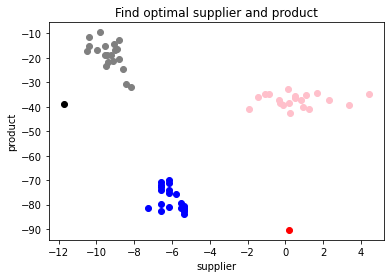

In [132]:
plt.scatter(ef_sup_energy,ef_item_energy,color='blue')

# now plot
plt.scatter(plot_sup1,plot_prod1,color='gray')
plt.scatter(plot_sup2,plot_prod2,color='pink')


# now plot
plt.scatter(dwave_plot_sup1,dwave_plot_prod1,color='black')
plt.scatter(dwave_plot_sup2,dwave_plot_prod2,color='red')

            
plt.xlabel('supplier')
plt.ylabel('product')
plt.title('Find optimal supplier and product')
plt.show()